## Cel modelu
Model ma za zadanie przewidywać zwycięską drużynę w meczu koszykówki na podstawie wybranych statystyk z poprzedzających meczy. 

## Wczytanie danych

### Pobranie danych - nba-api

NBA_api daje dostęp do danych z regularnego sezonu, playoffów i pre-sezonu.
Do modelowania wybrałem dane tylko z regularnych rozgrywek. \
Pre-sezon bywa nieprzewidywalny, drużyny często eksperymentują a jednocześnie zawodnicy nie czują presji. \
Analogicznie podczas fazy play-off dostępne są jedynie dane o lepiej grających drużynach, które bardziej się starają wygrać. \
Wskazuje na to niższa niż podczas regularnego sezonu wartość "upset rate", czyli wygranej drużyny, która typowana jest jako gorsza.

Api daje też dostęp do innych lig, ale skupiam się na danych NBA. \
Pobieram dane z ostatnich 10 lat (sezony 2012-2013 do 2022-2023 + kawałek sezonu 2023-2024) \
Koszykówka w NBA mocno ewoluuje na przestrzeni czasu, np. w ostatnich latach większy jest nacisk na rzuty za 3 pkt, \
dlatego może być konieczne ograniczyć ten zakres na potrzeby uczenia modelu.


In [1]:
from nba_api.stats.endpoints import TeamGameLogs
import pandas as pd
import numpy as np
import pickle

import polars as pl
import matplotlib.pylab as plt
import seaborn as sns

from statsmodels.stats.outliers_influence import variance_inflation_factor 
from scipy.stats.mstats import winsorize
from sklearn.preprocessing import MinMaxScaler

from sklearn.metrics import accuracy_score, precision_score, recall_score, roc_auc_score, roc_curve

from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit
from sklearn.base import BaseEstimator, TransformerMixin

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC

In [ ]:
seasons_list = [f"{start}-{end}" for start, end in zip( range(2012, 2024) , range(13, 25))]
seasons_list

In [ ]:
# Każdy mecz to dwa wiersze w tabeli - po jednym dla każdej ze stron
# league_id : nba 00, g_league 20, wnba 10
season_team_logs = [ TeamGameLogs(season_nullable = s, season_type_nullable = 'Regular Season', league_id_nullable ='00') for s in seasons_list ]
team_game_logs = [pgl.get_data_frames()[0] for pgl in season_team_logs]
df_team_game_logs = pd.concat(team_game_logs)
df_team_game_logs

In [ ]:
df_team_game_logs.to_parquet('./data_in/team_stats_2012_2024.parquet')

In [ ]:
df_team_game_logs['SEASON_YEAR'].value_counts()

## EDA - analiza danych wejściowych

In [2]:
# styl wykresów
plt.style.use('ggplot')
# wyświetlanie wyników w notebooku
pd.set_option('display.max_rows', 200)
pd.set_option('display.max_columns', 200)
pd.set_option('display.width', 500)

Patrzę na podstawowe statystyki kolumn

In [3]:
teams_stats = pl.read_parquet('./data_in/team_stats_2012_2024.parquet')
print(teams_stats.shape)
teams_stats.describe()

(28596, 58)


statistic,SEASON_YEAR,TEAM_ID,TEAM_ABBREVIATION,TEAM_NAME,GAME_ID,GAME_DATE,MATCHUP,WL,MIN,FGM,FGA,FG_PCT,FG3M,FG3A,FG3_PCT,FTM,FTA,FT_PCT,OREB,DREB,REB,AST,TOV,STL,BLK,BLKA,PF,PFD,PTS,PLUS_MINUS,GP_RANK,W_RANK,L_RANK,W_PCT_RANK,MIN_RANK,FGM_RANK,FGA_RANK,FG_PCT_RANK,FG3M_RANK,FG3A_RANK,FG3_PCT_RANK,FTM_RANK,FTA_RANK,FT_PCT_RANK,OREB_RANK,DREB_RANK,REB_RANK,AST_RANK,TOV_RANK,STL_RANK,BLK_RANK,BLKA_RANK,PF_RANK,PFD_RANK,PTS_RANK,PLUS_MINUS_RANK,AVAILABLE_FLAG,__index_level_0__
str,str,f64,str,str,str,str,str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""28596""",28596.0,"""28596""","""28596""","""28596""","""28596""","""28596""","""28596""",28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28596.0,28582.0,28596.0
"""null_count""","""0""",0.0,"""0""","""0""","""0""","""0""","""0""","""0""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14.0,0.0
"""mean""",null,1.6106e9,null,null,null,null,null,null,48.333962,39.720066,86.29616,0.461163,10.372535,28.923136,0.356967,17.404847,22.686215,0.767837,10.411736,33.295531,43.707267,23.681844,14.173591,7.641558,4.864072,4.864072,20.032837,20.032697,107.217513,0.0,1.0,598.622814,598.622814,598.622814,131.515876,1129.085921,1146.780144,1191.202581,1099.804413,1144.264513,1182.768149,1138.456008,1148.596552,1180.800112,1105.706952,1132.551895,1143.879494,1128.382571,1109.068086,1077.942754,1056.580955,1056.581165,1115.441705,1115.440936,1167.943139,1170.194293,1.005738,1194.745629
"""std""",null,8.651401,null,null,null,null,null,null,1.451684,5.354475,7.511355,0.055352,4.157884,8.712764,0.094057,5.963074,7.281725,0.103093,3.818602,5.445033,6.580792,5.24236,3.916555,2.903676,2.52605,2.52605,4.279532,4.279566,13.408079,14.264815,0.0,599.367545,599.367545,599.367545,38.112254,691.096404,691.459058,694.854536,682.91113,690.198835,693.608591,688.546916,689.899105,694.253908,684.392867,691.129857,691.743149,689.977741,696.875303,681.600891,672.437556,707.570157,696.029838,689.282092,693.271698,693.801125,0.121087,694.086764
"""min""","""2012-13""",1.6106e9,"""ATL""","""Atlanta Hawks""","""0021200001""","""2012-10-30T00:…","""ATL @ BKN""","""L""",47.985,19.0,60.0,0.269,0.0,4.0,0.0,1.0,1.0,0.143,0.0,12.0,17.0,6.0,1.0,0.0,0.0,0.0,5.0,5.0,58.0,-73.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0
"""25%""",null,1.6106e9,null,null,null,null,null,null,48.0,36.0,81.0,0.423,7.0,23.0,0.294,13.0,18.0,0.704,8.0,30.0,39.0,20.0,11.0,6.0,3.0,3.0,17.0,17.0,98.0,-9.0,1.0,1.0,1.0,1.0,117.0,538.0,538.0,581.0,504.0,531.0,591.0,543.0,550.0,584.0,510.0,531.0,545.0,533.0,471.0,470.0,512.0,425.0,523.0,531.0,556.0,573.0,1.0,595.0
"""50%""",null,1.6106e9,null,null,null,null,null,null,48.0,40.0,86.0,0.461,10.0,29.0,0.356,17.0,22.0,0.773,10.0,33.0,43.0,24.0,14.0,7.0,5.0,5.0,20.0,20.0,107.0,1.0,1.0,1060.0,1060.0,1060.0,139.0,1110.0,1135.0,1188.0,1088.0,1119.0,1183.0,1115.0,1111.0,1174.0,1094.0,1101.0,1119.0,1100.0,1078.0,997.0,942.0,1008.0,1110.0,1059.0,1135.0,1174.0,1.0,1191.0
"""75%""",null,1.6106e9,null,null,null,null,null,null,48.0,43.0,91.0,0.5,13.0,35.0,0.418,21.0,27.0,0.84,13.0,37.0,48.0,27.0,17.0,9.0,6.0,6.0,23.0,23.0,116.0,9.0,1.0,1231.0,1231.0,1231.0,153.0,1710.0,1733.0,1783.0,1651.0,1724.0,1773.0,1687.0,1734.0,1768.0,1632.0,1701.0,1731.0,1717.0,1714.0,1609.0,1631.0,1637.0,1701.0,1725.0,1748.0,1745.0,1.0,1787.0
"""max""",

In [4]:
teams_stats.head(10)

SEASON_YEAR,TEAM_ID,TEAM_ABBREVIATION,TEAM_NAME,GAME_ID,GAME_DATE,MATCHUP,WL,MIN,FGM,FGA,FG_PCT,FG3M,FG3A,FG3_PCT,FTM,FTA,FT_PCT,OREB,DREB,REB,AST,TOV,STL,BLK,BLKA,PF,PFD,PTS,PLUS_MINUS,GP_RANK,W_RANK,L_RANK,W_PCT_RANK,MIN_RANK,FGM_RANK,FGA_RANK,FG_PCT_RANK,FG3M_RANK,FG3A_RANK,FG3_PCT_RANK,FTM_RANK,FTA_RANK,FT_PCT_RANK,OREB_RANK,DREB_RANK,REB_RANK,AST_RANK,TOV_RANK,STL_RANK,BLK_RANK,BLKA_RANK,PF_RANK,PFD_RANK,PTS_RANK,PLUS_MINUS_RANK,AVAILABLE_FLAG,__index_level_0__
str,i64,str,str,str,str,str,str,f64,i64,i64,f64,i64,i64,f64,i64,i64,f64,i64,i64,i64,i64,f64,i64,i64,i64,i64,i64,i64,f64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,f64,i64
"""2012-13""",1610612755,"""PHI""","""Philadelphia 7…","""0021201221""","""2013-04-17T00:…","""PHI @ IND""","""W""",48.0,43,85,0.506,8,19,0.421,11,14,0.786,10,32,42,16,16.0,9,6,4,23,14,105,10.0,1,1,1,1,151,252,713,459,758,1250,660,2012,2128,994,1312,923,1151,2166,1503,655,682,731,1825,2211,618,512,1.0,0
"""2012-13""",1610612739,"""CLE""","""Cleveland Cava…","""0021201219""","""2013-04-17T00:…","""CLE @ CHA""","""L""",48.0,39,80,0.488,8,23,0.348,12,18,0.667,4,31,35,24,12.0,9,3,4,24,14,98,-7.0,1,1230,1230,1230,151,762,1407,671,758,630,1305,1857,1656,1936,2389,1109,2092,752,519,655,1729,731,1974,2211,1193,1648,1.0,1
"""2012-13""",1610612760,"""OKC""","""Oklahoma City …","""0021201226""","""2013-04-17T00:…","""OKC vs. MIL""","""L""",48.0,37,89,0.416,3,21,0.143,12,14,0.857,13,31,44,16,8.0,8,2,3,14,11,89,-6.0,1,1230,1230,1230,151,1144,340,1848,2180,879,2376,1857,2128,361,640,1109,861,2166,58,918,2035,425,147,2415,1901,1555,1.0,2
"""2012-13""",1610612737,"""ATL""","""Atlanta Hawks""","""0021201218""","""2013-04-17T00:…","""ATL @ NYK""","""L""",48.0,37,90,0.411,2,21,0.095,16,17,0.941,15,38,53,14,13.0,7,2,3,15,16,92,-6.0,1,1230,1230,1230,151,1144,277,1903,2337,879,2428,1212,1810,70,350,186,100,2321,744,1279,2035,425,249,1913,1697,1555,1.0,3
"""2012-13""",1610612748,"""MIA""","""Miami Heat""","""0021201220""","""2013-04-17T00:…","""MIA vs. ORL""","""W""",48.0,42,78,0.538,12,29,0.414,9,19,0.474,6,28,34,31,12.0,7,12,1,18,22,105,12.0,1,1,1,1,151,339,1690,170,146,150,717,2225,1519,2429,2196,1641,2184,87,519,1279,27,37,740,635,618,407,1.0,4
"""2012-13""",1610612742,"""DAL""","""Dallas Maveric…","""0021201224""","""2013-04-17T00:…","""DAL vs. NOH""","""W""",48.0,42,82,0.512,6,16,0.375,9,11,0.818,7,30,37,24,11.0,12,5,3,23,17,99,12.0,1,1,1,1,151,339,1131,387,1334,1724,999,2225,2314,660,2010,1289,1870,752,340,130,983,425,1825,1720,1102,407,0.0,5
"""2012-13""",1610612761,"""TOR""","""Toronto Raptor…","""0021201216""","""2013-04-17T00:…","""TOR vs. BOS""","""W""",48.0,40,80,0.5,12,21,0.571,22,28,0.786,9,37,46,26,11.0,5,5,2,14,22,114,24.0,1,1,1,1,151,585,1407,476,146,879,74,406,462,994,1576,263,596,451,340,1944,983,165,147,635,201,87,1.0,6
"""2012-13""",1610612756,"""PHX""","""Phoenix Suns""","""0021201227""","""2013-04-17T00:…","""PHX @ DEN""","""L""",48.0,40,104,0.385,7,25,0.28,11,17,0.647,20,27,47,29,13.0,8,5,8,18,13,98,-20.0,1,1230,1230,1230,151,585,12,2179,1049,424,1843,2012,1810,2064,48,1815,491,191,744,918,983,2006,740,2313,1193,2276,1.0,7
"""2012-13""",1610612765,"""DET""","""Detroit Piston…","""0021201217""","""2013-04-17T00:…","""DET @ BKN""","""L""",48.0,37,78,0.474,1,13,0.077,24,32,0.75,10,29,39,17,24.0,17,5,3,24,24,99,-4.0,1,1230,1230,1230,151,1144,1690,857,2422,2134,2440,242,208,1285,1312,1470,1598,2060,2428,2,983,425,1974,341,1102,1420,1.0,8


Zmienne "_RANK" określają ranking w całym sezonie. Nie wyglądają na przydatne, a też potencjalnie mogą zawierać informacje "z przyszłości" -> do wykluczenia \
Zmienne "AVAILABLE_FLAG" "index_level_0" nie zawierają przydatnych informacji -> do wykluczenia

Informację o zmiennej celu, wygrana w następnym meczu, trzeba zaciągnąć z kolejnego meczu danej drużyny. Grupowanie powinno zachodzić na poziomie drużyny ale też sezonu. \
Pomiędzy sezonami drużyny mogą przechodzić duże transformacje, wymiany zawodników/trenerów, zmiany strategii.

Data meczu jest przechowywana jako tekst, więc trzeba ją zamienić na format daty by móc odpowiednio sortować historię. \
Na podstawie kolumny "MATCHUP" można wyciągnąć informacje czy mecz jest rozgrywany w domu czy na wyjeździe. Drużyny grają inaczej u siebie, wygrywając ok 60% meczy. \
Dodaję też informacje o konferencji EAST/WEST. Historycznie drużyny różniły się stylem w zależności od wybrzeża. Różnice zmniejszyły się w osttanich latach ale może być przydatna informacja.

na początku analizowanego okresu New Orleans Pelicans i Charlotte Hornets zmieniały nazwy. Oprócz tego Los Angeles Clippers zmienili nazwę na skrót LA. Aktualizuje wszystkie nazwy do aktualnej.

In [5]:
conference_map = {
    'Minnesota Timberwolves': 'west',
    'Phoenix Suns': 'west',
    'Sacramento Kings': 'west',
    'Orlando Magic': 'east',
    'Utah Jazz': 'west',
    'Denver Nuggets': 'west',
    'San Antonio Spurs': 'west',
    'Houston Rockets': 'west',
    'Indiana Pacers': 'east',
    'LA Clippers': 'west',
    'Brooklyn Nets': 'east',
    'Golden State Warriors': 'west',
    'Milwaukee Bucks': 'east',
    'Washington Wizards': 'east',
    'Charlotte Hornets': 'east',
    'Atlanta Hawks': 'east',
    'Miami Heat': 'east',
    'Dallas Mavericks': 'west',
    'New York Knicks': 'east',
    'Los Angeles Lakers': 'west',
    'Toronto Raptors': 'east',
    'Memphis Grizzlies': 'west',
    'Chicago Bulls': 'east',
    'Portland Trail Blazers': 'west',
    'Philadelphia 76ers': 'east',
    'Boston Celtics': 'east',
    'Detroit Pistons': 'east',
    'Oklahoma City Thunder': 'west',
    'Cleveland Cavaliers': 'east',
    'New Orleans Pelicans': 'west',
}

In [6]:
teams_stats_prep = (
    teams_stats
    # wykluczenie niepotrzebnych kolumn
    .select( pl.exclude("^*_RANK$", 'AVAILABLE_FLAG', '__index_level_0__'))
    .with_columns(
        # zamiana typu daty
        pl.col("GAME_DATE").str.to_datetime(),
        # Zamiana sezonu na jedną liczbę
        pl.col("SEASON_YEAR").str.slice(0,4).cast(pl.Int16).alias('sezon'),
        # win/loss na zmienna binarną
        pl.when(pl.col("WL").eq("W")).then(1).otherwise(0).alias('WL_bin'),
        # wyłuskanie flagi gry "u siebie" 
        pl.when(pl.col('MATCHUP').str.contains('@')).then(0).otherwise(1).alias('is_homegame'),
        
        # aktualizuje nazwę i skrót drużyny do aktualnych danych
        pl.col('TEAM_NAME').replace(['New Orleans Hornets', 'Los Angeles Clippers','Charlotte Bobcats'],
                                    ['New Orleans Pelicans', 'LA Clippers', 'Charlotte Hornets']
                                    ).alias('TEAM_NAME'),
        pl.col('TEAM_ABBREVIATION').replace('NOH', 'NOP'
                                    ).alias('TEAM_ABBREVIATION'),
    )
    #sortowanie by zachować kolejność meczy
    .sort('GAME_DATE', 'GAME_ID')
    # dodanie zmiennej celu predykcji -> wynik następnego meczu danej drużyny
    .with_columns(
        pl.col('TEAM_NAME').replace(conference_map).alias('conference'),
        pl.col("WL_bin").shift(-1).over("TEAM_ID", 'sezon').alias("TARGET")
    )
)
teams_stats_prep.head()

SEASON_YEAR,TEAM_ID,TEAM_ABBREVIATION,TEAM_NAME,GAME_ID,GAME_DATE,MATCHUP,WL,MIN,FGM,FGA,FG_PCT,FG3M,FG3A,FG3_PCT,FTM,FTA,FT_PCT,OREB,DREB,REB,AST,TOV,STL,BLK,BLKA,PF,PFD,PTS,PLUS_MINUS,sezon,WL_bin,is_homegame,conference,TARGET
str,i64,str,str,str,datetime[μs],str,str,f64,i64,i64,f64,i64,i64,f64,i64,i64,f64,i64,i64,i64,i64,f64,i64,i64,i64,i64,i64,i64,f64,i16,i32,i32,str,i32
"""2012-13""",1610612764,"""WAS""","""Washington Wiz…","""0021200001""",2012-10-30 00:00:00,"""WAS @ CLE""","""L""",48.0,32,90,0.356,8,32,0.25,12,20,0.6,18,21,39,26,13.0,11,10,5,19,21,84,-10.0,2012,0,0,"""east""",0
"""2012-13""",1610612739,"""CLE""","""Cleveland Cava…","""0021200001""",2012-10-30 00:00:00,"""CLE vs. WAS""","""W""",48.0,36,79,0.456,7,20,0.35,15,22,0.682,18,36,54,22,21.0,7,5,10,21,19,94,10.0,2012,1,1,"""east""",0
"""2012-13""",1610612738,"""BOS""","""Boston Celtics…","""0021200002""",2012-10-30 00:00:00,"""BOS @ MIA""","""L""",48.0,39,75,0.52,6,13,0.462,23,28,0.821,7,34,41,24,16.0,4,2,5,23,20,107,-13.0,2012,0,0,"""east""",0
"""2012-13""",1610612748,"""MIA""","""Miami Heat""","""0021200002""",2012-10-30 00:00:00,"""MIA vs. BOS""","""W""",48.0,43,79,0.544,8,16,0.5,26,32,0.813,5,31,36,25,8.0,8,5,2,20,23,120,13.0,2012,1,1,"""east""",0
"""2012-13""",1610612747,"""LAL""","""Los Angeles La…","""0021200003""",2012-10-30 00:00:00,"""LAL vs. DAL""","""L""",48.0,38,77,0.494,3,13,0.231,12,31,0.387,15,31,46,24,14.0,6,5,5,21,25,91,-8.0,2012,0,1,"""west""",0


In [7]:
teams_stats_prep[['TEAM_NAME', 'conference']].unique().to_pandas()['conference'].value_counts()

conference
west    15
east    15
Name: count, dtype: int64

### Wartości brakujące
W pobranym zbiorze jedyne braki danych występują w zmiennej TARGET - dla ostatniego meczu zespołu w sezonie nie mamy informacji o kolejnym.

In [8]:
teams_stats_prep.null_count()

SEASON_YEAR,TEAM_ID,TEAM_ABBREVIATION,TEAM_NAME,GAME_ID,GAME_DATE,MATCHUP,WL,MIN,FGM,FGA,FG_PCT,FG3M,FG3A,FG3_PCT,FTM,FTA,FT_PCT,OREB,DREB,REB,AST,TOV,STL,BLK,BLKA,PF,PFD,PTS,PLUS_MINUS,sezon,WL_bin,is_homegame,conference,TARGET
u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,360


### Duplikaty wierszy
Nie ma duplikatów. Każdy mecz jest reprezentowany przez dwa wiersze - po jednym dla każdej ze stron meczu - ale jest to porządane.

In [9]:
teams_stats_prep.filter(teams_stats_prep.is_duplicated())

SEASON_YEAR,TEAM_ID,TEAM_ABBREVIATION,TEAM_NAME,GAME_ID,GAME_DATE,MATCHUP,WL,MIN,FGM,FGA,FG_PCT,FG3M,FG3A,FG3_PCT,FTM,FTA,FT_PCT,OREB,DREB,REB,AST,TOV,STL,BLK,BLKA,PF,PFD,PTS,PLUS_MINUS,sezon,WL_bin,is_homegame,conference,TARGET
str,i64,str,str,str,datetime[μs],str,str,f64,i64,i64,f64,i64,i64,f64,i64,i64,f64,i64,i64,i64,i64,f64,i64,i64,i64,i64,i64,i64,f64,i16,i32,i32,str,i32


### Podział danych po sezonach
Do oceny zdolności predykcyjnych modelu wykorzystuję dane z ostatnich sezonów - 2022-2023 i 2023-2024. (ok 16% danych przed preprocesingiem)\
Liczba meczy w sezonie jest stała. Regulaminowo powinno to być 82 na drużynę. \
Widać, że w latach 2020/21 odbyło się mniej meczy - prawdopodobnie przez COVID. Dane mogą nie być w pełni reprezentatywne, co oceniane jest dalej. \
Sezon 2023-24 jeszcze się nie zakończył, stąd mniej obserwacji.

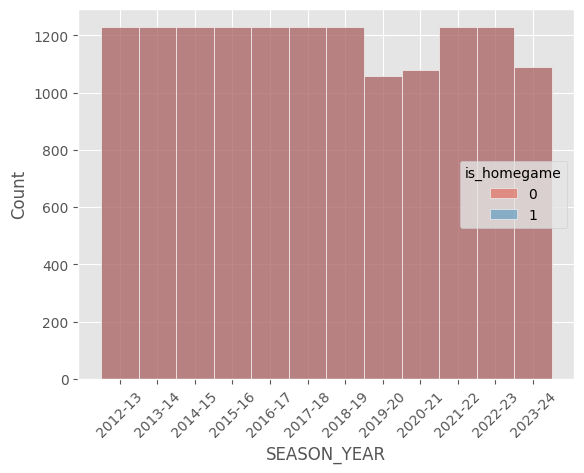

In [10]:
ax = sns.histplot(data = teams_stats_prep.to_pandas(), x='SEASON_YEAR', hue='is_homegame')
plt.xticks(rotation=45)
sns.move_legend(ax, "center right")
plt.show()

#### Zmienna minuty meczu

In [11]:
teams_stats_prep.to_pandas()['MIN'].value_counts()

MIN
48.000    26952
53.000     1414
58.000      194
63.000       28
68.000        6
47.985        2
Name: count, dtype: int64

Większość meczy trwa regulaminowe 48 minut. Kolejne wartości to dogrywki, każda trwa 5 minut. \
W dominującej części meczy nie ma dogrywki, większy sens ma zmienna binarna - czy była dogrywka. \
Potencjalnie dogrywka to bardziej wyrównana gra, a dłuższy mecz wpływa na zmęczenie zawodników porzed następnym meczem.

In [12]:
teams_stats_prep = (
    teams_stats_prep
    # dodanie zmiennej binarnej o dogrywce
    .with_columns(
        pl.when(pl.col('MIN').gt(48.0)).then(1).otherwise(0).alias('flaga_OT')
    )
)

#### Wykresy zmiennych
Wszystkie zmienne które mają wchodzić do modelu są numeryczne.

In [13]:
data = teams_stats_prep.select(pl.col(["SEASON_YEAR"]), pl.col(pl.NUMERIC_DTYPES) ).to_pandas()
num_columns = [col for col in list(data.columns) if col not in ['SEASON_YEAR', 'TEAM_ID', 'sezon', 'is_homegame', 'MIN', 'TARGET'] ]
num_columns

['FGM',
 'FGA',
 'FG_PCT',
 'FG3M',
 'FG3A',
 'FG3_PCT',
 'FTM',
 'FTA',
 'FT_PCT',
 'OREB',
 'DREB',
 'REB',
 'AST',
 'TOV',
 'STL',
 'BLK',
 'BLKA',
 'PF',
 'PFD',
 'PTS',
 'PLUS_MINUS',
 'WL_bin',
 'flaga_OT']

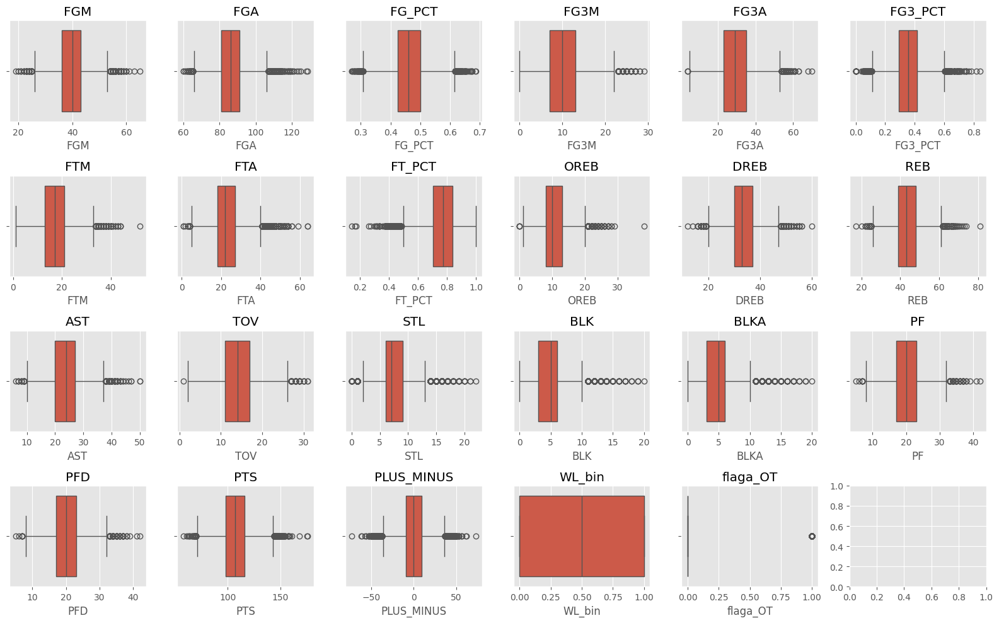

In [14]:
fig, ax = plt.subplots(len(num_columns)//6+1, 6, figsize=(16, 10))
for ii, column in enumerate(num_columns):
    # print(ii//3, ii%3)
    sns.boxplot(data=data[column], ax=ax[ii//6, ii%6], orient='h') 
    ax[ii//6, ii%6].title.set_text(column)
fig.tight_layout()
plt.show()

### podział na sezony
Widać wzrost rzutów za 3 pkt i ich wpływ na punkty, asysty i powiązane zmienne. \
Skalowanie względem danego sezonu powinno rozwiązać ten problem.

W każdej zmiennej widzimy wartości odstające - pojedyńcze mecze z nadmiarową liczbą punktów, fauli, zbiórek. \
Winsoryzacja do kwantyli .05 i .95 powinna rozwiązać ten problem. \
Usuwanie obserwacji mogło by zmniejszyć próbę uczącą, która nie jest ogromna, co może negatywnie wpłynąć na uczenie.

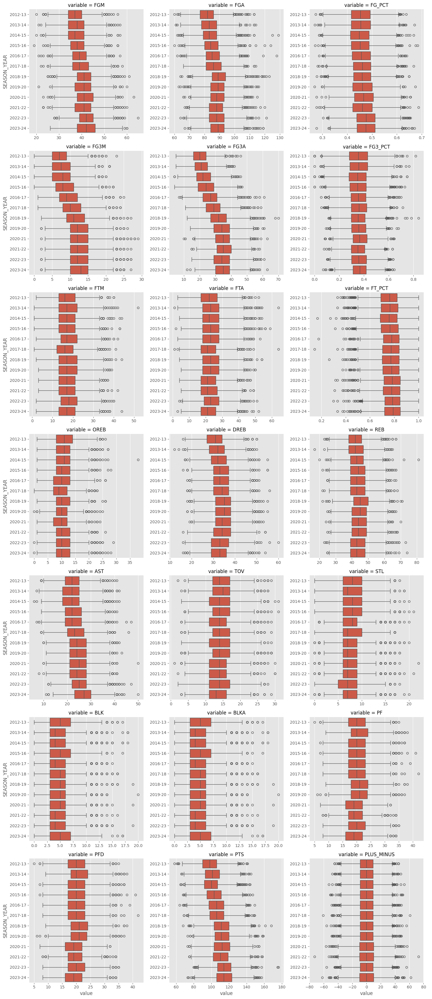

In [15]:
data = (
    teams_stats_prep
    # .filter(pl.col("TEAM_ID") == 1610612737)
    .select(pl.col(["SEASON_YEAR"] + num_columns[:-2]))
    .melt('SEASON_YEAR')
).to_pandas()

sns.catplot(
    data=data, y='SEASON_YEAR', x='value',
    col='variable', kind='box', col_wrap=3,
    sharey=False, sharex=False,
)

### Podział home/away
Widać nieznaczne różnice w rozkładach meczy u siebie i na wyjeździe. Nie powinno to mieć dużego wpływu na model.

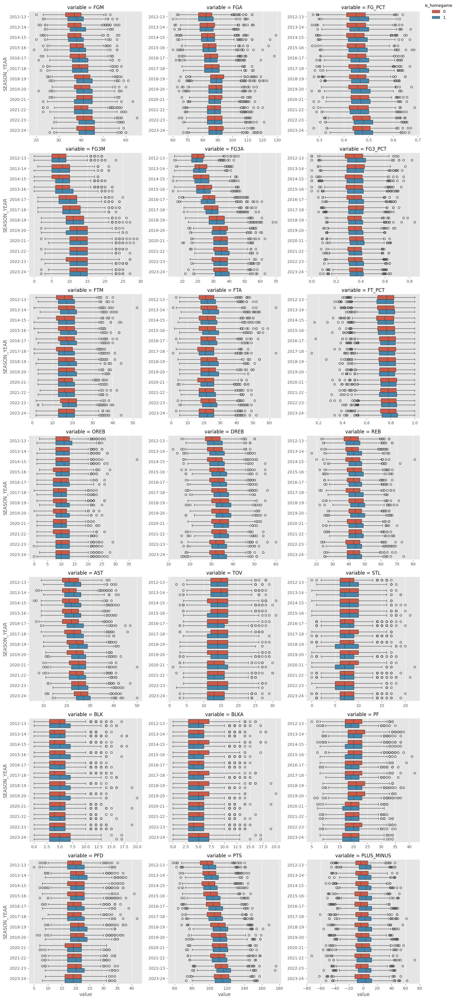

In [16]:
data = (
    teams_stats_prep
    # .filter(pl.col("TEAM_ID") == 1610612737)
    .select(pl.col(["SEASON_YEAR", 'is_homegame' ] + num_columns[:-2]))
    .melt(["SEASON_YEAR", 'is_homegame'])
).to_pandas()

ax =sns.catplot(
    data=data, y='SEASON_YEAR', x='value', hue='is_homegame',
    col='variable', kind='box', col_wrap=3,
    sharey=False, sharex=False
)
sns.move_legend(ax, "upper right")
plt.show()

### Podział na konferencje
Podobnie jak z flagą home/away dla konferencji nie ma zauważalnych istotnych różnic w rozkładach zmiennych.

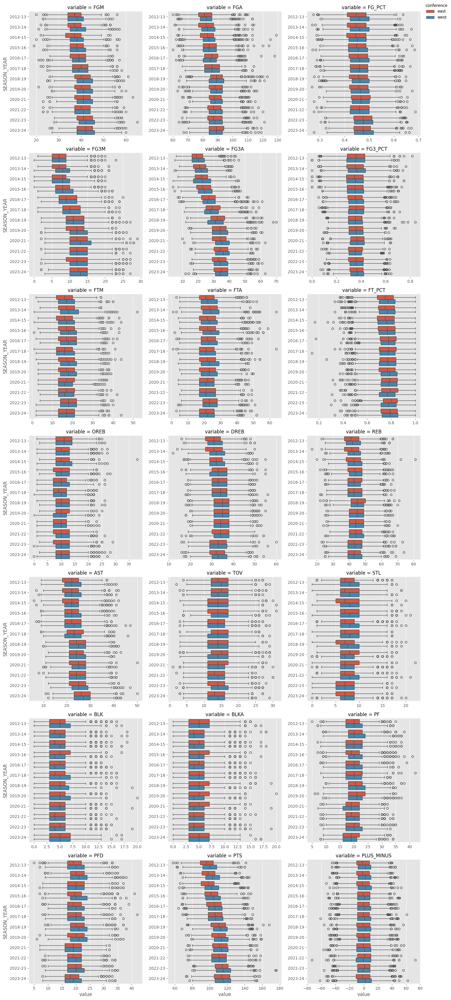

In [17]:
data = (
    teams_stats_prep
    # .filter(pl.col("TEAM_ID") == 1610612737)
    .select(pl.col(["SEASON_YEAR", 'conference' ] + num_columns[:-2]))
    .melt(["SEASON_YEAR", 'conference'])
).to_pandas()

ax = sns.catplot(
    data=data, y='SEASON_YEAR', x='value', hue='conference',
    col='variable', kind='box', col_wrap=3,
    sharey=False, sharex=False,
)
sns.move_legend(ax, "upper right")
plt.show()

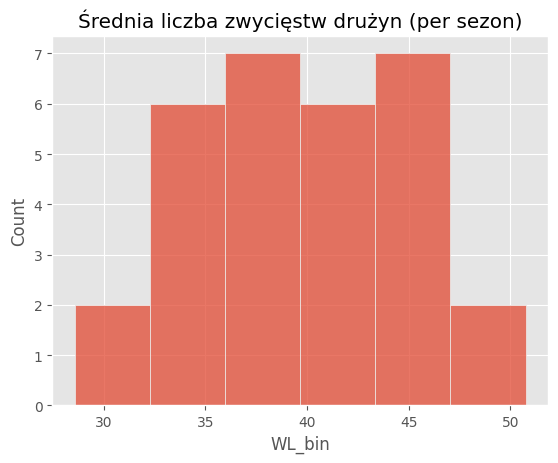

In [18]:
data=teams_stats_prep.group_by("SEASON_YEAR", "TEAM_NAME").agg(pl.col('WL_bin').sum()).group_by("TEAM_NAME").agg(pl.col('WL_bin').mean()).to_pandas()
sns.histplot(data, x='WL_bin')
plt.title("Średnia liczba zwycięstw drużyn (per sezon)")
plt.show()

### Powiązania zmiennych
W następnym kroku patrzę na korelacje liniowe pomiędzy zmiennymi. Silnie skorelowane zmienne mogą zakłucać proces uczenia modelu i pogarszać wynik.

<Axes: >

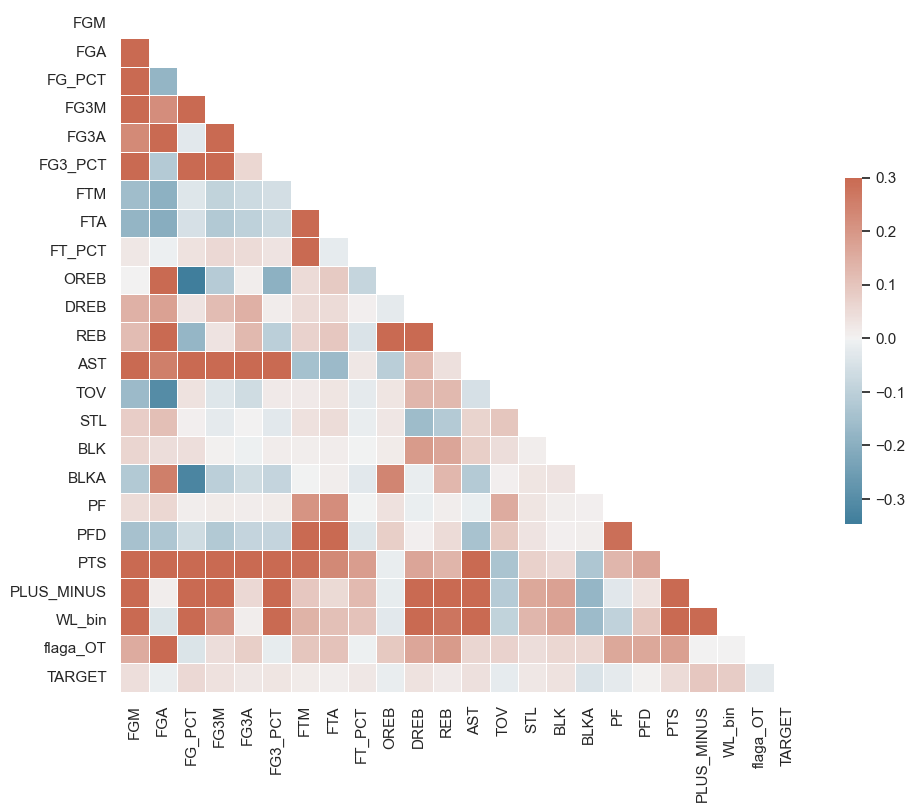

In [19]:
sns.set_theme(style="white")

corr = teams_stats_prep.to_pandas()[num_columns+['TARGET']].dropna().corr()
mask = np.triu(np.ones_like(corr, dtype=bool))

f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

#### Wnioski:
- Liczba punktów (PCT) jest powiązana z liczbą celnych rzutów (FGM).
- liczba celnych rzutów (FGM) jest powiązana z liczbą oddanych rzutów (FGA) i procentem celnych rzutów (FG_PCT).
- tak samo dla rzutów za 3 i rzutów osobistych.
    - zamiast stosować wszystkie zmienne może warto zostawić dwie: FGA i FG_PCT -> powinny zawierać te samą informację.
- Liczba zbiórek (REB) jest sumą zbiórek ofensywnych i defensywnych, więc z nimi ściśle powiązana -> nie wnosi nowych informacji.
- Liczba asyst jest powiązana ze zmiennymi dotyczącymi punktów, ale ekspercko można uznać to za istotną informację - potencjalnie zespół który podejmuje tylko indywidualne akcje jako taktyka.
- zmienna PLUS_MINUS jest powiązana z punktami, ale potencjalnie daje informacje o tym jak drużyna radzi sobie w obronie gdy podtrzymuje atak (jeśli dużo trafia to czy przypadkiem dużo nie przepuszcza)

Żadna ze zmiennych nie jest silnie liniowo skorelowana z celem.

Usuwam zmienne o celnych rzutach pozostawiając próbyi % skuteczności, usuwam sumę zbiórek, usuwam też zmienną o punktach zdobytych

### Współliniowość zmiennych (Variance Inflation Factor)
W modelu regresji logistycznej jednym z założeń jest brak zmiennych współliniowych. \
Na podstawie wskaźnika VIF można określicz jak bardzo współliniowe są zmienne - VIF powyżej 5. \
Rekurencyjnie ręcznie usuwam zmienne z listy kandydatek, by pozostała lista bez współliniowości.

In [20]:
data = teams_stats_prep.to_pandas()[num_columns].dropna()
# dodanie stałej zgodnie z dokumentacją statsmodels
data['const'] = 1
# VIF dataframe 
vif_data = pd.DataFrame() 
vif_data["feature"] = data.columns 
  
# calculating VIF for each feature 
vif_data["VIF"] = [variance_inflation_factor(data.values, i) 
                          for i in range(len(data.columns))]
vif_data

f:\Programming\miniConda\envs\NBApredict\lib\site-packages\statsmodels\stats\outliers_influence.py:198: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


,feature,VIF
0,FGM,inf
1,FGA,77.612756
2,FG_PCT,135.803978
3,FG3M,inf
4,FG3A,17.096656
5,FG3_PCT,10.199999
6,FTM,inf
7,FTA,57.945024
8,FT_PCT,8.742732
9,OREB,inf


Usuwam zmienne powiązane z celnymi rzutami i liczbą punktów, które wcześniej wykazywały (niskie) korelacje.

In [21]:
selected_columns = [ col for col in num_columns.copy() if col not in ['FGM', 'FG3M', 'FTM', 'REB', 'PTS' ] ]
selected_columns

['FGA',
 'FG_PCT',
 'FG3A',
 'FG3_PCT',
 'FTA',
 'FT_PCT',
 'OREB',
 'DREB',
 'AST',
 'TOV',
 'STL',
 'BLK',
 'BLKA',
 'PF',
 'PFD',
 'PLUS_MINUS',
 'WL_bin',
 'flaga_OT']

In [22]:
data = teams_stats_prep.to_pandas()[selected_columns].dropna()
# dodanie stałej zgodnie z dokumentacją statsmodels
data['const'] = 1
# VIF dataframe 
vif_data = pd.DataFrame() 
vif_data["feature"] = data.columns 
  
# calculating VIF for each feature 
vif_data["VIF"] = [variance_inflation_factor(data.values, i) 
                          for i in range(len(data.columns))]
vif_data

,feature,VIF
0,FGA,3.859359
1,FG_PCT,3.096136
2,FG3A,1.471217
3,FG3_PCT,1.528948
4,FTA,3.205780
5,FT_PCT,1.064695
6,OREB,2.434820
7,DREB,2.404375
8,AST,2.001794
9,TOV,1.991287


### Rozkłady zmiennych parami
Patrząc na wszystkie pary zauważyłem 3 zmienne "podejrzane" i przyglądam się im dokładniej.

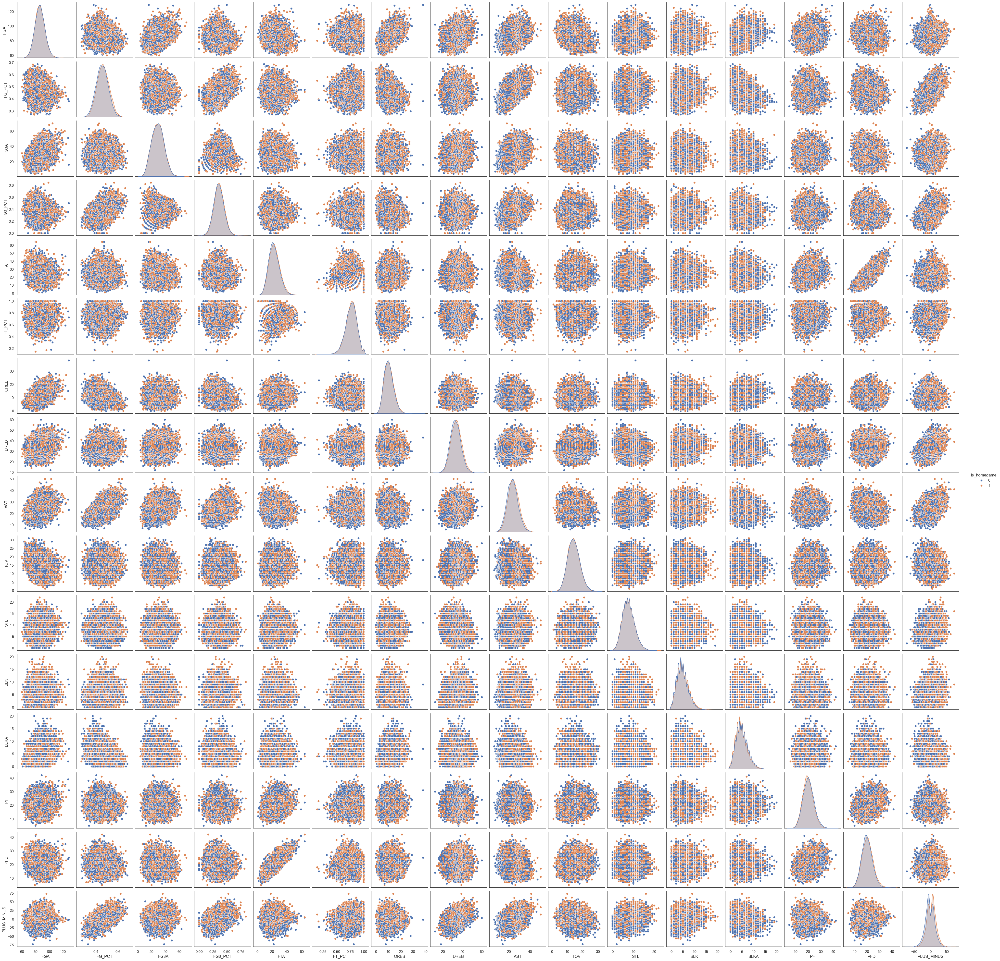

In [23]:
sns.pairplot(teams_stats_prep.to_pandas(),
    vars = selected_columns[:-2],
    hue='is_homegame')
plt.show()

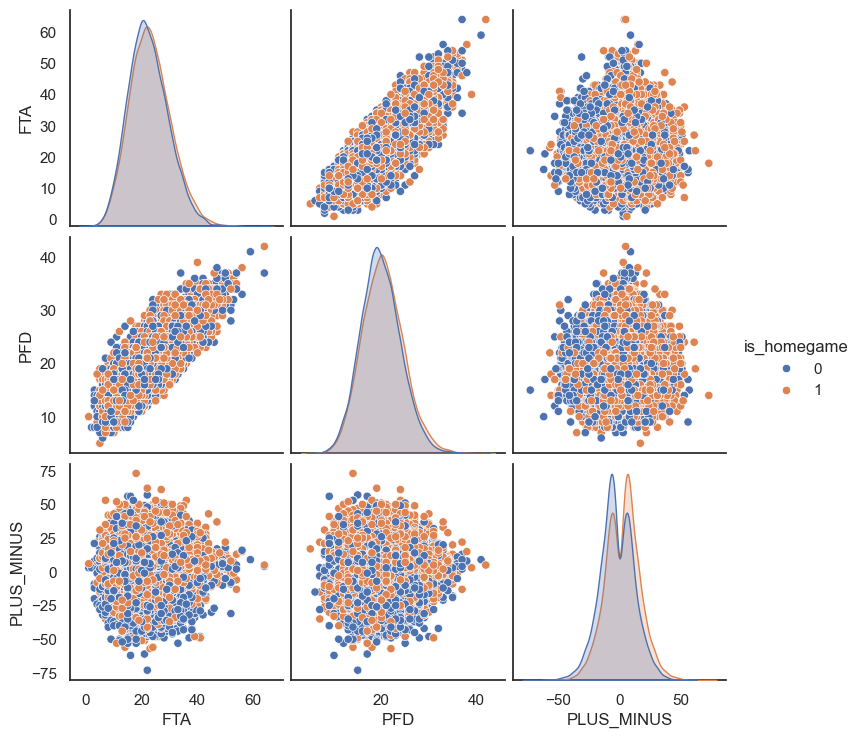

In [24]:
sns.pairplot(teams_stats_prep.to_pandas(),
    vars = ['FTA', 'PFD', 'PLUS_MINUS'],
    hue='is_homegame')
plt.show()

PFD (wymuszone faule przeciwnika) wygląda na skorelowane z FTA (oddane rzuty osobiste) co ma sens. \
Rozkład zmiennej PLUS_MINUS jnie jest rozkładem normalnym i różni się w zależności od tego czy gra drużyna u siebie czy na wyjeździe. Zmienna wykazywała też umiarkowaną współiniowość (na granicy 5). \
Zmienne usuwam z listy kandydatek.

In [25]:
selected_columns.remove('PFD')
selected_columns.remove('PLUS_MINUS')

### Baseline model
Tworzę podstawowy model na bazowej liście zmiennych, jako podstawa do oceny kolejnych wyników. \
Wykorzytuje co do zasady domyślne parametry funkcji, bez optymalizacji hiperparametrów.

In [26]:
df = teams_stats_prep.drop_nulls().to_pandas().copy()
df_train = df.query('sezon < 2022').copy()
df_test  = df.query('sezon >= 2022').copy()

Próba testowa (~1.5 sezonu), stanowi ok 16% całej próby.

In [27]:
df_test.shape[0]/(df.shape[0])

0.16220427822637767

**Regresja logistyczna** jest dobrym kandydatem dla postawionego problemu: binarna klasyfikacja wyników meczu. 

Parametr $ penalty ='l1' $ oznacza implementacje reguralyzacji LASSO, która pomaga w doborze zmiennych.

In [28]:
logReg = LogisticRegression(penalty='l1', solver='liblinear', random_state=42)
logReg.fit(df_train[selected_columns], df_train['TARGET'])
y_pred = logReg.predict(df_test[selected_columns])
y_pred_proba = logReg.predict_proba(df_test[selected_columns])[:, 1]

accuracy = accuracy_score(df_test['TARGET'], y_pred)
precision = precision_score(df_test['TARGET'], y_pred)
recall = recall_score(df_test['TARGET'], y_pred)
auc_score = roc_auc_score(df_test['TARGET'], y_pred_proba)

print(f"Accuracy:\t{accuracy:.3f}" )
print(f"Precision:\t{precision:.3f}")
print(f"Recall:\t\t{recall:.3f}")
print(f"AUC Score:\t{auc_score:.3f}")



Accuracy:	0.541
Precision:	0.537
Recall:		0.593
AUC Score:	0.553


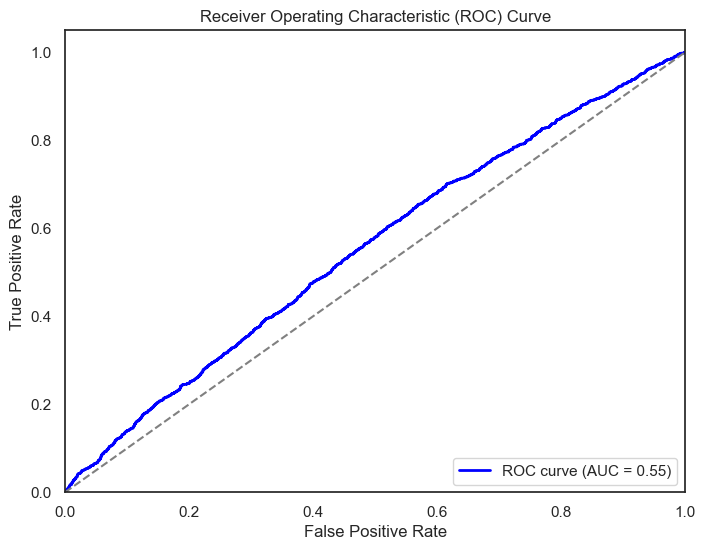

In [29]:
fpr, tpr, thresholds = roc_curve(df_test['TARGET'], y_pred_proba)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label='ROC curve (AUC = %0.2f)' % auc_score)
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

In [30]:
np.savetxt('./model_input/baseline_fpr.csv', fpr, delimiter=', ',fmt ='% s')
np.savetxt('./model_input/baseline_tpr.csv', tpr, delimiter=', ',fmt ='% s')

### Zjawisko "Home advantage"
W wielu sportach, szczególnie w koszykówce NBA, panuje przeświadczenie o przewadze drużyny, która gra u siebie. Jest to uwzględniowe w zakładach sportowych jak i w mentalności zawodników. \
Dane statystyczne zdają się wspierać tę hipotezę. W przeszłości ok 60% meczy granych na domowym boisku było wygrywane. W przygotowanym zbiorze ten udział jest trochę niższy, szczególnie w ostatnich latach.

Stworzony podstawowy model ma skuteczność trochę powyżej modelu naiwnego, który zakłada wygraną drużyny gospodarzy. 

ACC home=win: 0.5278372591006424


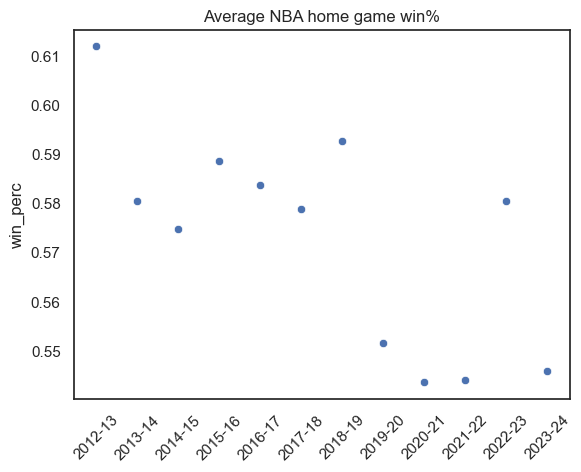

In [93]:
print(f"ACC home=win: {accuracy_score(df_test['TARGET'], df_test['is_homegame'])}")

data = (
    teams_stats_prep
    .filter(pl.col('is_homegame').eq(1))
    .group_by('SEASON_YEAR').agg(pl.col('WL_bin').mean().alias('win_perc'))
    .sort('SEASON_YEAR')
)
sns.scatterplot(data.to_pandas(), x='SEASON_YEAR', y='win_perc')
plt.xticks(rotation=45)
plt.title('Average NBA home game win%')
plt.xlabel('')
plt.show()

### Średnie wartości z poprzednich meczy
Aby usprawnić model, dodaje informacje o tym jak historycznie drużyna sobie radzi. \
Średnia z ostatnich N meczy daję informacje o potencjalnym progresie/pogorszeniu się drużyny.

Minusem takiego podejścia jest to, że pierwsze N gier sezonu nie bierze udziału w uczeniu (dane z poprzedniego sezonu nie muszą być reprezentatywne dla sezonu następnego).

Liczba *N* meczy jest hiperparametrem modelu wybieranym później.

In [32]:
teams_stats_avg = (
    teams_stats_prep
    .sort("TEAM_ID","GAME_DATE", "GAME_ID")
    # rolling avg
    .with_columns(
        (
            pl.col(x).rolling_mean(window_size=N).over("TEAM_ID", "SEASON_YEAR").alias(f"{x}_av{N}")
                for N in [3, 4, 5, 6, 7, 8, 9, 10]
                for x in selected_columns
        )
    )
)
teams_stats_avg

SEASON_YEAR,TEAM_ID,TEAM_ABBREVIATION,TEAM_NAME,GAME_ID,GAME_DATE,MATCHUP,WL,MIN,FGM,FGA,FG_PCT,FG3M,FG3A,FG3_PCT,FTM,FTA,FT_PCT,OREB,DREB,REB,AST,TOV,STL,BLK,BLKA,PF,PFD,PTS,PLUS_MINUS,sezon,WL_bin,is_homegame,conference,TARGET,flaga_OT,FGA_av3,…,BLK_av8,BLKA_av8,PF_av8,WL_bin_av8,flaga_OT_av8,FGA_av9,FG_PCT_av9,FG3A_av9,FG3_PCT_av9,FTA_av9,FT_PCT_av9,OREB_av9,DREB_av9,AST_av9,TOV_av9,STL_av9,BLK_av9,BLKA_av9,PF_av9,WL_bin_av9,flaga_OT_av9,FGA_av10,FG_PCT_av10,FG3A_av10,FG3_PCT_av10,FTA_av10,FT_PCT_av10,OREB_av10,DREB_av10,AST_av10,TOV_av10,STL_av10,BLK_av10,BLKA_av10,PF_av10,WL_bin_av10,flaga_OT_av10
str,i64,str,str,str,datetime[μs],str,str,f64,i64,i64,f64,i64,i64,f64,i64,i64,f64,i64,i64,i64,i64,f64,i64,i64,i64,i64,i64,i64,f64,i16,i32,i32,str,i32,i32,f64,…,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""2012-13""",1610612737,"""ATL""","""Atlanta Hawks""","""0021200018""",2012-11-02 00:00:00,"""ATL vs. HOU""","""L""",48.0,40,85,0.471,7,22,0.318,15,17,0.882,7,29,36,23,13.0,12,4,2,26,18,102,-7.0,2012,0,1,"""east""",1,0,null,…,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
"""2012-13""",1610612737,"""ATL""","""Atlanta Hawks""","""0021200040""",2012-11-04 00:00:00,"""ATL @ OKC""","""W""",48.0,41,83,0.494,8,25,0.32,14,20,0.7,12,26,38,20,11.0,12,1,9,20,21,104,9.0,2012,1,0,"""east""",1,0,null,…,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
"""2012-13""",1610612737,"""ATL""","""Atlanta Hawks""","""0021200055""",2012-11-07 00:00:00,"""ATL vs. IND""","""W""",48.0,38,87,0.437,7,22,0.318,6,12,0.5,17,34,51,24,17.0,8,3,7,15,14,89,3.0,2012,1,1,"""east""",0,0,85.0,…,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
"""2012-13""",1610612737,"""ATL""","""Atlanta Hawks""","""0021200072""",2012-11-09 00:00:00,"""ATL vs. MIA""","""L""",48.0,34,81,0.42,9,25,0.36,12,16,0.75,7,29,36,20,13.0,4,5,2,16,22,89,-6.0,2012,0,1,"""east""",0,0,83.666667,…,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
"""2012-13""",1610612737,"""ATL""","""Atlanta Hawks""","""0021200091""",2012-11-11 00:00:00,"""ATL @ LAC""","""L""",48.0,30,72,0.417,9,25,0.36,7,16,0.438,10,31,41,20,22.0,3,9,6,12,22,76,-13.0,2012,0,0,"""east""",1,0,80.0,…,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
"""2023-24""",1610612766,"""CHA""","""Charlotte Horn…","""0022300969""",2024-03-16 00:00:00,"""CHA @ PHI""","""L""",48.0,37,82,0.451,10,31,0.323,14,18,0.778,12,28,40,21,16.0,11,4,4,21,23,98,-11.0,2023,0,0,"""east""",0,0,86.0,…,3.875,4.625,16.875,0.25,0.0,86.111111,0.458444,34.333333,0.315111,17.222222,0.771889,9.111111,31.333333,22.777778,13.222222,7.888889,4.111111,4.888889,16.444444,0.222222,0.0,85.7,0.4565,34.8,0.3144,17.5,0.7697,9.1,31.5,22.9,13.2,7.4,4.0,4.7,16.6,0.2,0.0
"""2023-24""",1610612766,"""CHA""","""Charlotte Horn…","""0022300991""",2024-03-19 00:00:00,"""CHA @ ORL""","""L""",48.0,38,79,0.481,9,29,0.31,7,9,0.778,4,26,30,19,17.0,8,1,6,13,10,92,-20.0,2023,0,0,"""east""",0,0,85.0,…,3.25,4.625,16.625,0.25,0.0,85.555556,0.455,33.888889,0.302444,16.333333,0.766778,8.777778,31.444444,22.222222,14.555556,8.222222,3.555556,4.777778,16.444444,0.222222,0.0,85.4,0.4607,33.

In [33]:
selected_columns_avg = teams_stats_avg.select(
    pl.col(selected_columns),
    pl.col("^*_av\d+$")
).columns

### Dane przeciwnika
Dodaję również dane przeciwnika - przed meczem wiemy z kim będzie grać dna drużyna i jak przeciwnik sobie radził w ostatnich meczach. \
Informację o przeciwniku wyciągam ze zmiennej "MATCHUP"

In [34]:
teams_stats_opp = (
    teams_stats_avg
    .sort('GAME_DATE', descending=False)
    .with_columns(
        pl.col('MATCHUP').str.slice(-3,3).alias('opponent')
    )
    # add target for prediction
    .with_columns(
        pl.col("opponent").shift(-1).over("TEAM_ID").alias("next_opponent"),
        pl.col("GAME_ID").shift(-1).over("TEAM_ID").alias("next_GAME_ID"),
        pl.col("is_homegame").shift(-1).over("TEAM_ID").alias("next_is_homegame")
    )
)

In [35]:
teams_stats_opp = teams_stats_opp.join(
    teams_stats_opp.select(
        pl.col(['next_GAME_ID','TEAM_ABBREVIATION',] + selected_columns_avg)
    ),
    left_on=['next_GAME_ID', 'next_opponent'],
    right_on=['next_GAME_ID', 'TEAM_ABBREVIATION'],
    how='left',
    suffix='_opp',
).sort('GAME_DATE', descending=False)
teams_stats_opp.shape

(28596, 312)

In [36]:
selected_columns_opp = teams_stats_opp.select(
    pl.col(selected_columns_avg),
    pl.col("^*_opp$"), 
).columns

### Finalny podział train test

In [37]:
df = teams_stats_opp.drop_nulls().to_pandas().copy()
df_train = df.query('sezon <= 2022').copy()
df_test  = df.query('sezon >= 2023').copy()

selected_columns_final = selected_columns_opp.copy()
selected_columns_base = selected_columns.copy()

Zapisuję na dysk zbiory przed podziałem próby

In [38]:
teams_stats_prep.write_parquet('./model_input/teams_stats_prep.parquet')
teams_stats_avg.write_parquet('./model_input/teams_stats_avg.parquet')
teams_stats_opp.write_parquet('./model_input/teams_stats_opp.parquet')

In [39]:
np.savetxt('./model_input/selected_columns_base.csv', selected_columns_base, delimiter=', ',fmt ='% s')
np.savetxt('./model_input/selected_columns_final.csv', selected_columns_final, delimiter=', ',fmt ='% s')

## Winsoryzacja & Skalowanie

Winsoryzacja - ograniczenie wartości w zbiorze do minimalnego i maksymalnego kwantyla. Pomaga ograniczyć wpływ wartości odstających. \
Potencjalnie działa lepiej niż usunięcie outlierów z próbki, ze względnu na liczność zbioru uczącego.

Nie winsoryzuje danych testowych by zobaczyć jak potencjalnie model działa na nieznanych danych

Zbiory potem skaluje by pomóc w zbieżności do rozwiązania.

In [40]:
df_train[selected_columns_final]= df_train[selected_columns_final].apply(lambda x: winsorize(x,limits=[.05,.05]))

scaler = MinMaxScaler()
df_train[selected_columns_final] = scaler.fit_transform(df_train[selected_columns_final])

# zbiór testowy skalowany zgodnie z parametrami zbioru uczącego
df_test[selected_columns_final] = scaler.transform(df_test[selected_columns_final])

Zapisuję na dysk zbiory po winsoryzacji i skalowaniu

In [41]:
df_train.to_parquet('./model_input/df_train.parquet')
df_test.to_parquet('./model_input/df_test.parquet')

In [42]:
df_train = pl.read_parquet('./model_input/df_train.parquet').to_pandas()
df_test  = pl.read_parquet('./model_input/df_test.parquet').to_pandas()

In [43]:
with open("./model_input/selected_columns_base.csv") as fp:
    lines = fp.readlines()
    selected_columns_base = [line.strip() for line in lines]
with open("./model_input/selected_columns_final.csv") as fp:
    lines = fp.readlines()
    selected_columns_final = [line.strip() for line in lines]

## Estymacja modeli LASSO
### optymalizacja hiperparametrów
Optymalizacji podlegają parametry: 
* N - liczba poprzedzających obserwacji branych do uśredniani. Wartości [3, 5, 7, 10]
* C - odwrotność siły regularyzacji. Wartości skali logarytmicznej między 0.001 a 1

Mniejsze wartości stałej C oznaczają silniejszą regularyzację, wybór mniejszej liczby zmiennych. \
Większe wartości C mniej ograniczają model, ale wpływają na większą złożoność i overfitting.

Do oceny modeli wykorzystywana jest cross-walidacja z podziałem 5 razy.

gridsearch test

In [44]:
class AverageColumnSelector(BaseEstimator, TransformerMixin):
    def __init__(self, N):
        self.N = N

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        column_names = selected_columns_base + [col for col in X.columns if f'{self.N}' in col]
        return X[column_names]

In [45]:
logReg = LogisticRegression(penalty='l1', solver='liblinear')

pipeline = Pipeline([
    ('average_column_selector', AverageColumnSelector(N=None)),
    ('logreg', logReg) 
])

param_grid = {
    'logreg__C': np.logspace(np.log10(0.001), np.log10(1), num=30), 
    'average_column_selector__N': [2, 3, 4, 5, 6, 7, 8, 9, 10],
    'logreg__max_iter': [100],  
    'logreg__random_state': [42], 
}
tscv = TimeSeriesSplit(n_splits=5)

grid_search = GridSearchCV(pipeline, param_grid, cv=tscv, scoring='accuracy')


In [46]:
# Fit the grid search to find the best hyperparameters
grid_search.fit(df_train[selected_columns_final], df_train['TARGET'])

GridSearchCV(cv=TimeSeriesSplit(gap=0, max_train_size=None, n_splits=5, test_size=None),
             estimator=Pipeline(steps=[('average_column_selector',
                                        AverageColumnSelector(N=None)),
                                       ('logreg',
                                        LogisticRegression(penalty='l1',
                                                           solver='liblinear'))]),
             param_grid={'average_column_selector__N': [2, 3, 4, 5, 6, 7, 8, 9,
                                                        10],
                         'logreg__C': array([0.001     , 0.00126896, 0.00161026, 0.00204...0259294,
       0.00329034, 0.00417532, 0.00529832, 0.00672336, 0.00853168,
       0.01082637, 0.01373824, 0.01743329, 0.02212216, 0.02807216,
       0.03562248, 0.04520354, 0.05736153, 0.07278954, 0.09236709,
       0.11721023, 0.14873521, 0.18873918, 0.23950266, 0.30391954,
       0.38566204, 0.48939009, 0.62101694, 0.78804628, 1.        ]),
                         'logreg__max_iter': [100],
                         'logreg__random_state': [42]},
             scoring='accuracy')

In [47]:
with open('grid_search_results_C_N.pkl', 'wb') as f:
    pickle.dump(grid_search, f)

In [48]:
with open('grid_search_results_C_N.pkl', 'rb') as f:
    loaded_grid_search = pickle.load(f)

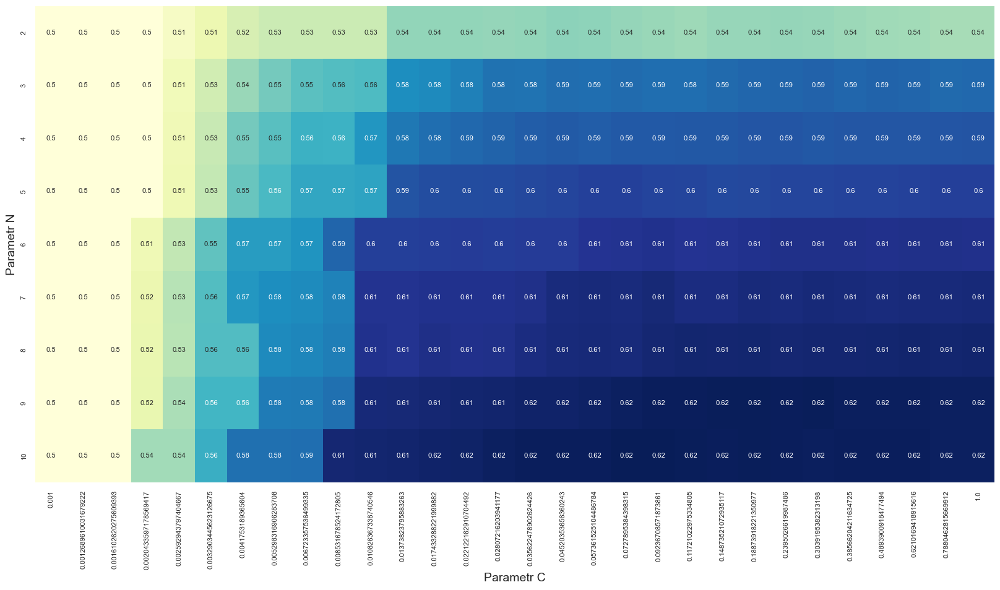

In [49]:
results_df = pd.DataFrame(grid_search.cv_results_)
relevant_columns = ['param_average_column_selector__N', 'param_logreg__C', 'mean_test_score']
results_df = results_df[relevant_columns]
table = results_df.pivot(index='param_average_column_selector__N', columns='param_logreg__C', values='mean_test_score')

plt.subplots(figsize = (20,10))
ax = sns.heatmap(table, annot=True, annot_kws={"size": 8}, cmap="YlGnBu", cbar=False)
ax.set_xlabel("Parametr C", fontsize=14)
ax.set_ylabel("Parametr N", fontsize=14)
plt.tick_params(axis='both', labelsize=8)
plt.show()

In [50]:
print("Best Hyperparameters:", grid_search.best_params_)
print("Best Cross-Validation Accuracy:", grid_search.best_score_)

Best Hyperparameters: {'average_column_selector__N': 10, 'logreg__C': 0.09236708571873861, 'logreg__max_iter': 100, 'logreg__random_state': 42}
Best Cross-Validation Accuracy: 0.6200628601361969


In [51]:
best_params = grid_search.best_params_

best_N = best_params['average_column_selector__N']
best_C = best_params['logreg__C']

best_selector = AverageColumnSelector(N=best_N)

best_pipeline = Pipeline([
    ('average_column_selector', best_selector),
    ('logreg', LogisticRegression(penalty='l1', solver='liblinear', C=best_C, max_iter=10000))
])
best_pipeline.fit(df_train[selected_columns_final], df_train['TARGET'])

Pipeline(steps=[('average_column_selector', AverageColumnSelector(N=10)),
                ('logreg',
                 LogisticRegression(C=0.09236708571873861, max_iter=10000,
                                    penalty='l1', solver='liblinear'))])

In [52]:
with open('best_logReg.pkl', 'wb') as f:
    pickle.dump(best_pipeline, f)

In [53]:
y_pred = best_pipeline.predict(df_test[selected_columns_final])
y_pred_proba = best_pipeline.predict_proba(df_test[selected_columns_final])[:, 1]

In [54]:
accuracy = accuracy_score(df_test['TARGET'], y_pred)
precision = precision_score(df_test['TARGET'], y_pred)
recall = recall_score(df_test['TARGET'], y_pred)
auc_score = roc_auc_score(df_test['TARGET'], y_pred_proba)

print(f"Accuracy:\t{accuracy:.3f}" )
print(f"Precision:\t{precision:.3f}")
print(f"Recall:\t\t{recall:.3f}")
print(f"AUC Score:\t{auc_score:.3f}")

Accuracy:	0.643
Precision:	0.645
Recall:		0.639
AUC Score:	0.691


In [55]:
with open("./model_input/baseline_fpr.csv") as fp:
    lines = fp.readlines()
    baseline_fpr = [float(line.strip()) for line in lines]
with open("./model_input/baseline_tpr.csv") as fp:
    lines = fp.readlines()
    baseline_tpr = [float(line.strip()) for line in lines]

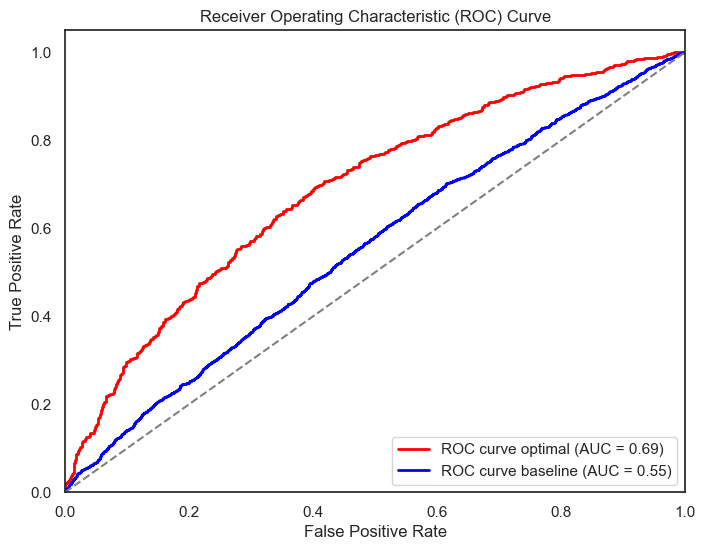

In [56]:
fpr, tpr, thresholds = roc_curve(df_test['TARGET'], y_pred_proba)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='red', lw=2, label=f'ROC curve optimal (AUC = {auc_score:.2f})')
plt.plot(baseline_fpr, baseline_tpr, color='blue', lw=2, label='ROC curve baseline (AUC = 0.55)') # baseline model
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

In [83]:
logreg_coefficients = best_pipeline.named_steps['logreg'].coef_[0]
selected_columns = selected_columns_base + [col for col in df_train.columns if f'{best_N}' in col]
df_features = pd.DataFrame({'zmienna': selected_columns, 'coef': logreg_coefficients})
df_features['coef_abs'] = np.abs(df_features['coef'])
df_features['zmienna_opp'] = np.where(df_features['zmienna'].str.contains('opp'), True, False)

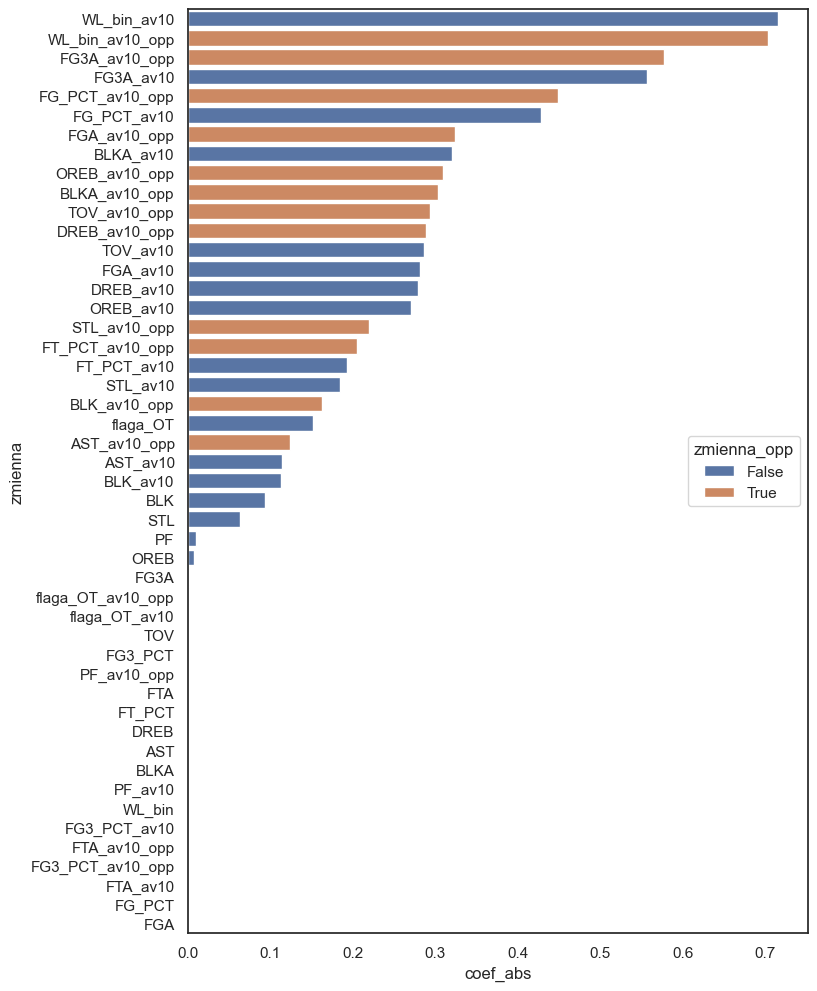

In [87]:
plt.figure(figsize=(8, 12))
ax = sns.barplot(df_features.sort_values('coef_abs', ascending=False),
            y='zmienna',
            x='coef_abs',
            hue='zmienna_opp')
sns.move_legend(ax, "center right")
plt.show()

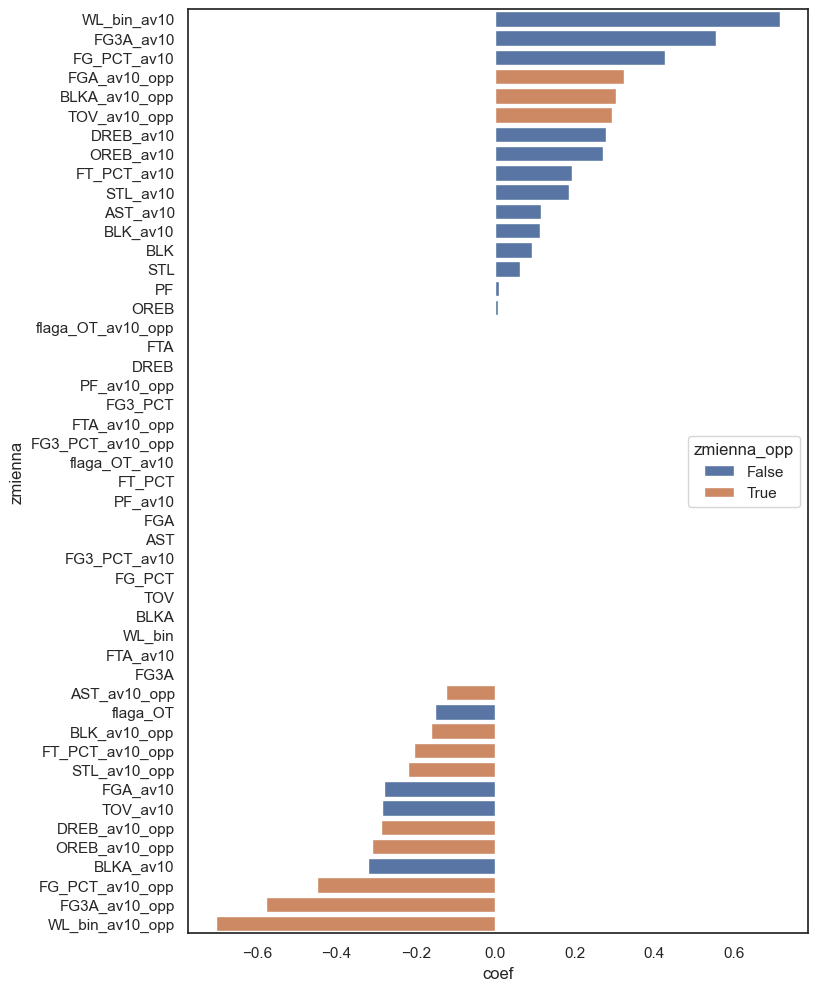

In [94]:
plt.figure(figsize=(8, 12))
ax = sns.barplot(df_features.sort_values('coef', ascending=False),
            y='zmienna',
            x='coef',
            hue='zmienna_opp')
sns.move_legend(ax, "center right")
plt.show()

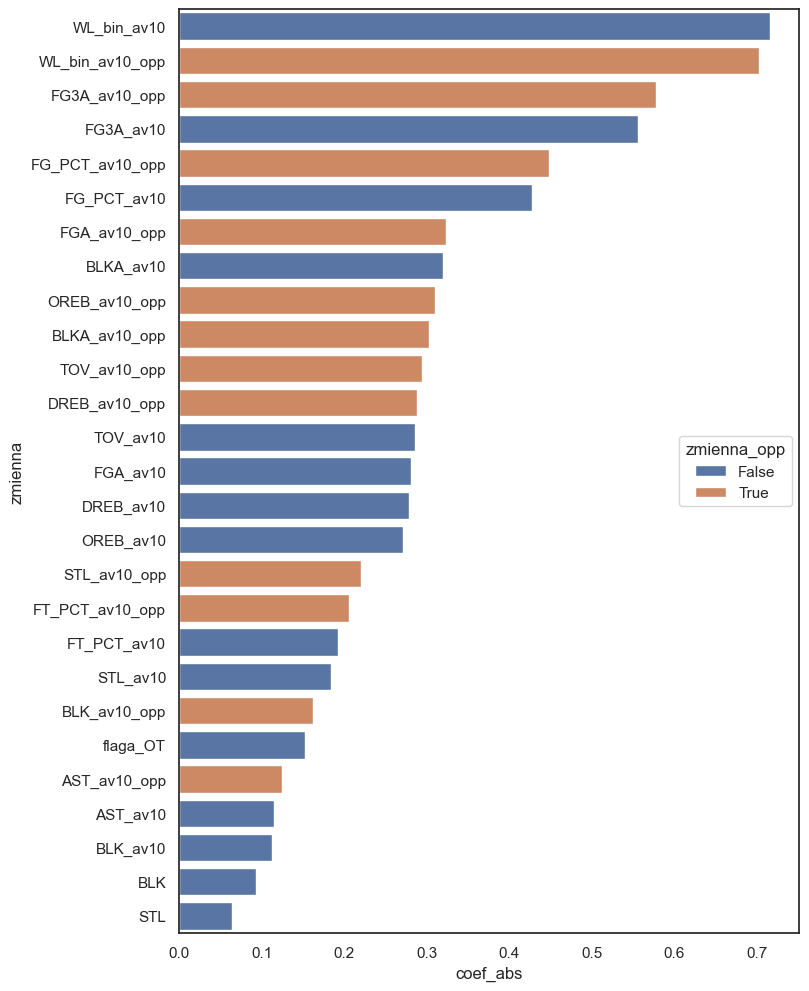

In [88]:
plt.figure(figsize=(8, 12))
ax = sns.barplot(df_features[df_features['coef_abs']>0.05].sort_values('coef_abs', ascending=False),
            y='zmienna',
            x='coef_abs',
            hue='zmienna_opp')
sns.move_legend(ax, "center right")
plt.show()

In [59]:
df_features[df_features['coef_abs']>0.05].sort_values('zmienna', ascending=False).reset_index(drop=True)[['zmienna','coef']]

,zmienna,coef
0,flaga_OT,-0.152005
1,WL_bin_av10_opp,-0.702787
2,WL_bin_av10,0.715569
3,TOV_av10_opp,0.293433
4,TOV_av10,-0.286113
5,STL_av10_opp,-0.219699
6,STL_av10,0.184278
7,STL,0.063286
8,OREB_av10_opp,-0.309744
9,OREB_av10,0.270662


## Wnioski z modelu

In [60]:
# TODO

## Modele alternatywne

Las losowy

In [61]:
forest = RandomForestClassifier(n_estimators = 100, max_depth=8, random_state=42)
forest.fit(df_train[selected_columns_final], df_train['TARGET'])

y_pred = forest.predict(df_test[selected_columns_final])
y_pred_proba = forest.predict_proba(df_test[selected_columns_final])[:, 1]

accuracy = accuracy_score(df_test['TARGET'], y_pred)
precision = precision_score(df_test['TARGET'], y_pred)
recall = recall_score(df_test['TARGET'], y_pred)
auc_score = roc_auc_score(df_test['TARGET'], y_pred_proba)

print(f"Accuracy:\t{accuracy:.3f}" )
print(f"Precision:\t{precision:.3f}")
print(f"Recall:\t\t{recall:.3f}")
print(f"AUC Score:\t{auc_score:.3f}")

Accuracy:	0.639
Precision:	0.635
Recall:		0.651
AUC Score:	0.689


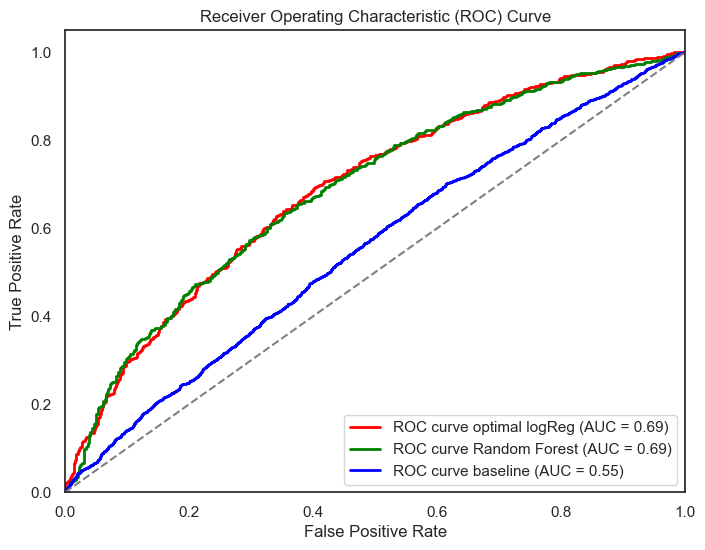

In [62]:
forest_fpr, forest_tpr, _ = roc_curve(df_test['TARGET'], y_pred_proba)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='red', lw=2, label=f'ROC curve optimal logReg (AUC = 0.69)')
plt.plot(forest_fpr, forest_tpr, color='green', lw=2, label=f'ROC curve Random Forest (AUC = {auc_score:.2f})')
plt.plot(baseline_fpr, baseline_tpr, color='blue', lw=2, label='ROC curve baseline (AUC = 0.55)') # baseline model
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

SVM - jądro liniowe

In [63]:
svm = SVC(kernel='linear')

svm.fit(df_train[selected_columns_final], df_train['TARGET'])
preds = svm.predict(df_test[selected_columns_final])


In [64]:
accuracy = accuracy_score(df_test['TARGET'], preds)
precision = precision_score(df_test['TARGET'], preds)
recall = recall_score(df_test['TARGET'], preds)

print(f"Accuracy:\t{accuracy:.3f}" )
print(f"Precision:\t{precision:.3f}")
print(f"Recall:\t\t{recall:.3f}")

Accuracy:	0.623
Precision:	0.624
Recall:		0.619


SVM - jądro RBF, radial basis function, Gaussian

In [65]:
svm = SVC(kernel='rbf', probability=True)

svm.fit(df_train[selected_columns_final], df_train['TARGET'])
preds = svm.predict(df_test[selected_columns_final])

y_pred = svm.predict(df_test[selected_columns_final])
y_pred_proba = svm.predict_proba(df_test[selected_columns_final])[:, 1]

accuracy = accuracy_score(df_test['TARGET'], y_pred)
precision = precision_score(df_test['TARGET'], y_pred)
recall = recall_score(df_test['TARGET'], y_pred)
auc_score = roc_auc_score(df_test['TARGET'], y_pred_proba)

print(f"Accuracy:\t{accuracy:.3f}" )
print(f"Precision:\t{precision:.3f}")
print(f"Recall:\t\t{recall:.3f}")
print(f"AUC Score:\t{auc_score:.3f}")

Accuracy:	0.632
Precision:	0.632
Recall:		0.632
AUC Score:	0.674


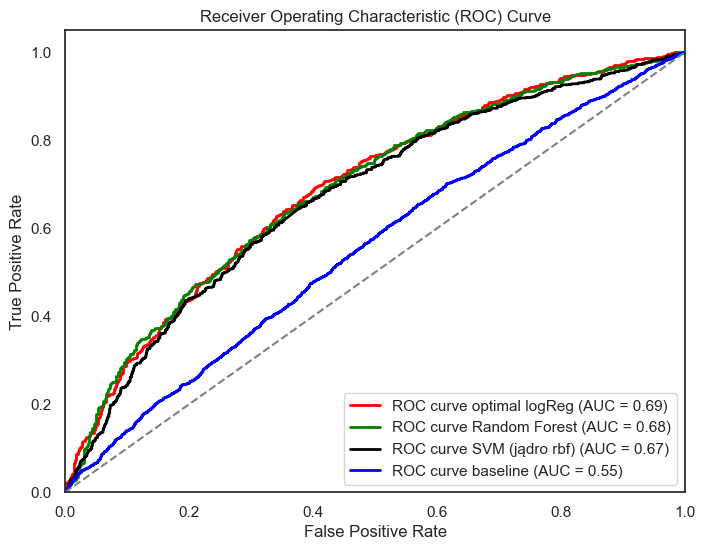

In [66]:
svm_fpr, svm_tpr, _ = roc_curve(df_test['TARGET'], y_pred_proba)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='red', lw=2, label=f'ROC curve optimal logReg (AUC = 0.69)')
plt.plot(forest_fpr, forest_tpr, color='green', lw=2, label=f'ROC curve Random Forest (AUC = 0.68)')
plt.plot(svm_fpr, svm_tpr, color='black', lw=2, label=f'ROC curve SVM (jądro rbf) (AUC = {auc_score:.2f})')
plt.plot(baseline_fpr, baseline_tpr, color='blue', lw=2, label='ROC curve baseline (AUC = 0.55)') # baseline model
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

## Zmienne diff

In [67]:
teams_stats_opp = pl.read_parquet('./model_input/teams_stats_opp.parquet')
with open("./model_input/selected_columns_base.csv") as fp:
    lines = fp.readlines()
    selected_columns_base = [line.strip() for line in lines]
with open("./model_input/selected_columns_final.csv") as fp:
    lines = fp.readlines()
    selected_columns_final = [line.strip() for line in lines]

In [68]:
coll_to_diff = [col for col in selected_columns_final if 'opp' not in col]
coll_to_diff

['FGA',
 'FG_PCT',
 'FG3A',
 'FG3_PCT',
 'FTA',
 'FT_PCT',
 'OREB',
 'DREB',
 'AST',
 'TOV',
 'STL',
 'BLK',
 'BLKA',
 'PF',
 'WL_bin',
 'flaga_OT',
 'FGA_av3',
 'FG_PCT_av3',
 'FG3A_av3',
 'FG3_PCT_av3',
 'FTA_av3',
 'FT_PCT_av3',
 'OREB_av3',
 'DREB_av3',
 'AST_av3',
 'TOV_av3',
 'STL_av3',
 'BLK_av3',
 'BLKA_av3',
 'PF_av3',
 'WL_bin_av3',
 'flaga_OT_av3',
 'FGA_av4',
 'FG_PCT_av4',
 'FG3A_av4',
 'FG3_PCT_av4',
 'FTA_av4',
 'FT_PCT_av4',
 'OREB_av4',
 'DREB_av4',
 'AST_av4',
 'TOV_av4',
 'STL_av4',
 'BLK_av4',
 'BLKA_av4',
 'PF_av4',
 'WL_bin_av4',
 'flaga_OT_av4',
 'FGA_av5',
 'FG_PCT_av5',
 'FG3A_av5',
 'FG3_PCT_av5',
 'FTA_av5',
 'FT_PCT_av5',
 'OREB_av5',
 'DREB_av5',
 'AST_av5',
 'TOV_av5',
 'STL_av5',
 'BLK_av5',
 'BLKA_av5',
 'PF_av5',
 'WL_bin_av5',
 'flaga_OT_av5',
 'FGA_av6',
 'FG_PCT_av6',
 'FG3A_av6',
 'FG3_PCT_av6',
 'FTA_av6',
 'FT_PCT_av6',
 'OREB_av6',
 'DREB_av6',
 'AST_av6',
 'TOV_av6',
 'STL_av6',
 'BLK_av6',
 'BLKA_av6',
 'PF_av6',
 'WL_bin_av6',
 'flaga_OT_av6',

In [69]:
teams_stats_diff = (
    teams_stats_opp
    .with_columns(
        (
            (pl.col(x) - pl.col(F"{x}_opp")).alias(f"{x}_compare")
                for x in coll_to_diff
        )
    )
)
selected_columns_diff = [col for col in teams_stats_diff.columns if '_compare' in col] 
teams_stats_diff = teams_stats_diff[selected_columns_diff + ['TARGET', 'sezon']]

In [70]:
df_diff = teams_stats_diff.drop_nulls().to_pandas().copy()
df_train_diff = df_diff.query('sezon <= 2022').copy()
df_test_diff  = df_diff.query('sezon >= 2023').copy()

In [71]:
df_train_diff[selected_columns_diff]= df_train_diff[selected_columns_diff].apply(lambda x: winsorize(x,limits=[.05,.05]))

scaler_diff = MinMaxScaler()
df_train_diff[selected_columns_diff] = scaler_diff.fit_transform(df_train_diff[selected_columns_diff])

# zbiór testowy skalowany zgodnie z parametrami zbioru uczącego
df_test_diff[selected_columns_diff] = scaler_diff.transform(df_test_diff[selected_columns_diff])

In [72]:
df_train_diff.to_parquet('./model_input/df_train_diff.parquet')
df_test_diff.to_parquet('./model_input/df_test_diff.parquet')

In [73]:
df_train_diff[selected_columns_diff]

,FGA_compare,FG_PCT_compare,FG3A_compare,FG3_PCT_compare,FTA_compare,FT_PCT_compare,OREB_compare,DREB_compare,AST_compare,TOV_compare,STL_compare,BLK_compare,BLKA_compare,PF_compare,WL_bin_compare,flaga_OT_compare,FGA_av3_compare,FG_PCT_av3_compare,FG3A_av3_compare,FG3_PCT_av3_compare,FTA_av3_compare,FT_PCT_av3_compare,OREB_av3_compare,DREB_av3_compare,AST_av3_compare,TOV_av3_compare,STL_av3_compare,BLK_av3_compare,BLKA_av3_compare,PF_av3_compare,WL_bin_av3_compare,flaga_OT_av3_compare,FGA_av4_compare,FG_PCT_av4_compare,FG3A_av4_compare,FG3_PCT_av4_compare,FTA_av4_compare,FT_PCT_av4_compare,OREB_av4_compare,DREB_av4_compare,AST_av4_compare,TOV_av4_compare,STL_av4_compare,BLK_av4_compare,BLKA_av4_compare,PF_av4_compare,WL_bin_av4_compare,flaga_OT_av4_compare,FGA_av5_compare,FG_PCT_av5_compare,FG3A_av5_compare,FG3_PCT_av5_compare,FTA_av5_compare,FT_PCT_av5_compare,OREB_av5_compare,DREB_av5_compare,AST_av5_compare,TOV_av5_compare,STL_av5_compare,BLK_av5_compare,BLKA_av5_compare,PF_av5_compare,WL_bin_av5_compare,flaga_OT_av5_compare,FGA_av6_compare,FG_PCT_av6_compare,FG3A_av6_compare,FG3_PCT_av6_compare,FTA_av6_compare,FT_PCT_av6_compare,OREB_av6_compare,DREB_av6_compare,AST_av6_compare,TOV_av6_compare,STL_av6_compare,BLK_av6_compare,BLKA_av6_compare,PF_av6_compare,WL_bin_av6_compare,flaga_OT_av6_compare,FGA_av7_compare,FG_PCT_av7_compare,FG3A_av7_compare,FG3_PCT_av7_compare,FTA_av7_compare,FT_PCT_av7_compare,OREB_av7_compare,DREB_av7_compare,AST_av7_compare,TOV_av7_compare,STL_av7_compare,BLK_av7_compare,BLKA_av7_compare,PF_av7_compare,WL_bin_av7_compare,flaga_OT_av7_compare,FGA_av8_compare,FG_PCT_av8_compare,FG3A_av8_compare,FG3_PCT_av8_compare,FTA_av8_compare,FT_PCT_av8_compare,OREB_av8_compare,DREB_av8_compare,AST_av8_compare,TOV_av8_compare,STL_av8_compare,BLK_av8_compare,BLKA_av8_compare,PF_av8_compare,WL_bin_av8_compare,flaga_OT_av8_compare,FGA_av9_compare,FG_PCT_av9_compare,FG3A_av9_compare,FG3_PCT_av9_compare,FTA_av9_compare,FT_PCT_av9_compare,OREB_av9_compare,DREB_av9_compare,AST_av9_compare,TOV_av9_compare,STL_av9_compare,BLK_av9_compare,BLKA_av9_compare,PF_av9_compare,WL_bin_av9_compare,flaga_OT_av9_compare,FGA_av10_compare,FG_PCT_av10_compare,FG3A_av10_compare,FG3_PCT_av10_compare,FTA_av10_compare,FT_PCT_av10_compare,OREB_av10_compare,DREB_av10_compare,AST_av10_compare,TOV_av10_compare,STL_av10_compare,BLK_av10_compare,BLKA_av10_compare,PF_av10_compare,WL_bin_av10_compare,flaga_OT_av10_compare
0,0.03125,0.419608,0.90625,0.781321,0.529412,1.000000,0.111111,0.416667,0.375000,0.277778,0.285714,0.583333,0.333333,0.00,1.0,0.5,0.000000,0.675847,0.805556,0.703704,0.687500,0.465039,0.000000,0.456522,0.434783,0.647059,0.500000,0.545455,0.363636,0.277778,7.500000e-01,0.0,0.000000,0.669039,0.728261,0.692391,0.907895,0.326493,0.175,0.482143,0.500000,0.725,0.366667,0.615385,0.269231,0.113636,0.666667,0.0,0.000000,0.673313,0.736364,0.637331,0.659091,0.444980,0.145833,0.453125,0.515152,0.652174,0.277778,0.466667,0.333333,0.230769,0.666667,0.0,0.000000,0.731608,0.676923,0.600877,0.52,0.546819,0.000000e+00,0.513889,0.460526,0.634615,0.300,0.294118,0.029412,0.155172,0.666667,0.0,0.000000,0.891892,0.689189,0.786741,0.427273,0.561849,0.000000,0.6875,0.600000,0.672414,0.227273,0.236842,0.138889,0.234375,0.750,0.0,0.000000,0.961538,0.704819,0.871257,0.508333,0.698995,0.000000,0.636364,0.659574,0.531250,0.375000,0.214286,0.225,0.250000,0.875,0.25,0.000000,0.957247,0.731183,0.962396,0.500000,0.753938,0.000000,0.593750,0.673077,0.632353,0.346154,0.239130,0.136364,0.243590,0.7,0.25,0.000000,1.000000,0.684466,1.000000,0.570423,0.755656,0.000000,0.568627,0.741071,0.486486,0.327586,0.12,0.130435,0.226190,8.000000e-01,0.25
1,0.96875,0.584314,0.09375,0.216401,0.470588,0.000000,0.888889,0.583333,0.625000,0.722222,0.714286,0.416667,0.666667,1.00,0.0,0.5,1.000000,0.324153,0.194444,0.295019,0.312500,0.533851,1.000000,0.543478,0.565217,0.352941,0.500000,0.454545,0.636364,0.722222,2.500000e-01,1.0,1.000000,0.330961,0.271739,0.307609,0.092105,0.671642,0.8

In [74]:
class AverageColumnSelector_diff(BaseEstimator, TransformerMixin):
    def __init__(self, N):
        self.N = N

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        column_names =  [col for col in X.columns if f'_av{self.N}' in col] + [''.join([col, '_compare']) for col in selected_columns_base]
        return X[column_names]

In [75]:
pipeline_diff = Pipeline([
    ('average_column_selector', AverageColumnSelector_diff(N=None)),  
    ('logreg', LogisticRegression(penalty='l1', solver='liblinear'))  
])

param_grid = {
    'logreg__C': np.logspace(np.log10(0.001), np.log10(1), num=30), 
    'average_column_selector__N': [2, 3, 4, 5, 6, 7, 8, 9, 10],
    'logreg__max_iter': [1000], 
    'logreg__random_state': [42], 
}
tscv = TimeSeriesSplit(n_splits=5) 

grid_search_diff = GridSearchCV(pipeline_diff, param_grid, cv=tscv, scoring='accuracy')


In [76]:
grid_search_diff.fit(df_train_diff[selected_columns_diff], df_train_diff['TARGET'])

GridSearchCV(cv=TimeSeriesSplit(gap=0, max_train_size=None, n_splits=5, test_size=None),
             estimator=Pipeline(steps=[('average_column_selector',
                                        AverageColumnSelector_diff(N=None)),
                                       ('logreg',
                                        LogisticRegression(penalty='l1',
                                                           solver='liblinear'))]),
             param_grid={'average_column_selector__N': [2, 3, 4, 5, 6, 7, 8, 9,
                                                        10],
                         'logreg__C': array([0.001     , 0.00126896, 0.00161026, 0....259294,
       0.00329034, 0.00417532, 0.00529832, 0.00672336, 0.00853168,
       0.01082637, 0.01373824, 0.01743329, 0.02212216, 0.02807216,
       0.03562248, 0.04520354, 0.05736153, 0.07278954, 0.09236709,
       0.11721023, 0.14873521, 0.18873918, 0.23950266, 0.30391954,
       0.38566204, 0.48939009, 0.62101694, 0.78804628, 1.        ]),
                         'logreg__max_iter': [1000],
                         'logreg__random_state': [42]},
             scoring='accuracy')

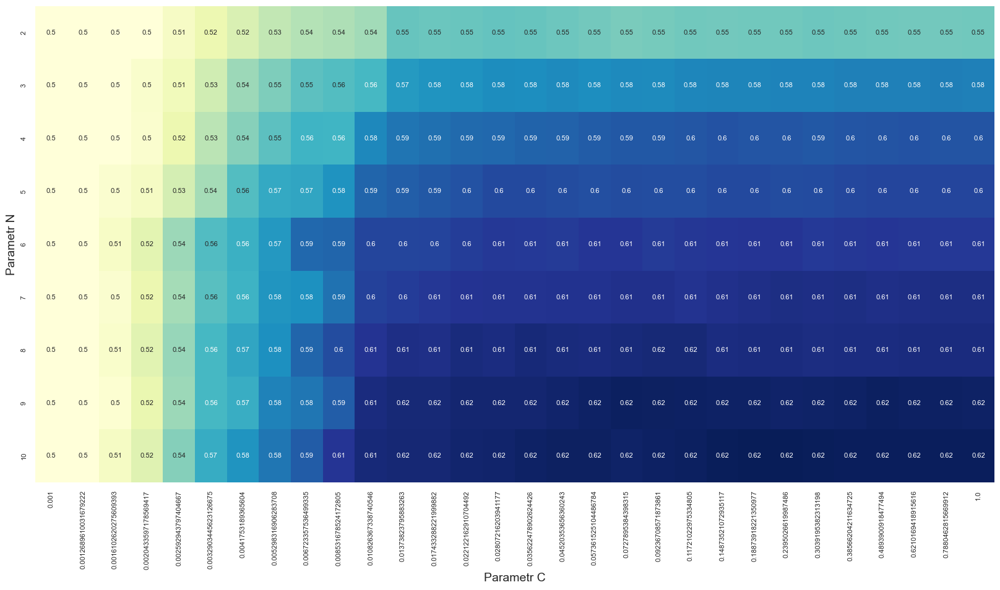

In [77]:
results_df = pd.DataFrame(grid_search_diff.cv_results_)
relevant_columns = ['param_average_column_selector__N', 'param_logreg__C', 'mean_test_score']
results_df = results_df[relevant_columns]
table = results_df.pivot(index='param_average_column_selector__N', columns='param_logreg__C', values='mean_test_score')

plt.subplots(figsize = (20,10))
ax = sns.heatmap(table, annot=True, annot_kws={"size": 8}, cmap="YlGnBu", cbar=False)
ax.set_xlabel("Parametr C", fontsize=14)
ax.set_ylabel("Parametr N", fontsize=14)
plt.tick_params(axis='both', labelsize=8)
plt.show()

In [78]:
best_params_diff = grid_search_diff.best_params_

# Extract the value of N from the best_params_diff
best_N_diff = best_params_diff['average_column_selector__N']
best_C_diff = best_params_diff['logreg__C']

print(best_N_diff, best_C_diff)
# Create the AverageColumnSelector with the best value of N
best_selector_diff = AverageColumnSelector_diff(N=best_N_diff)

# Create a pipeline with the best AverageColumnSelector and LogisticRegression
best_pipeline_diff = Pipeline([
    ('average_column_selector', best_selector_diff),
    ('logreg', LogisticRegression(penalty='l1', solver='liblinear', C=best_C_diff))
])
best_pipeline_diff.fit(df_train_diff[selected_columns_diff], df_train_diff['TARGET'])

10 0.18873918221350977


Pipeline(steps=[('average_column_selector', AverageColumnSelector_diff(N=10)),
                ('logreg',
                 LogisticRegression(C=0.18873918221350977, penalty='l1',
                                    solver='liblinear'))])

In [79]:
with open('best_logReg_diff.pkl', 'wb') as f:
    pickle.dump(best_pipeline_diff, f)

Accuracy:	0.633
Precision:	0.633
Recall:		0.633
AUC Score:	0.689


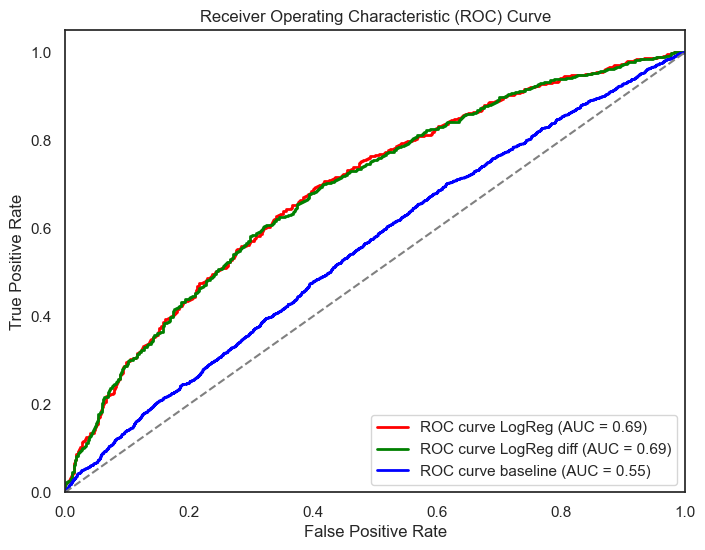

In [80]:
y_pred = best_pipeline_diff.predict(df_test_diff[selected_columns_diff])
y_pred_proba = best_pipeline_diff.predict_proba(df_test_diff[selected_columns_diff])[:, 1]

accuracy = accuracy_score(df_test_diff['TARGET'], y_pred)
precision = precision_score(df_test_diff['TARGET'], y_pred)
recall = recall_score(df_test_diff['TARGET'], y_pred)
auc_score = roc_auc_score(df_test_diff['TARGET'], y_pred_proba)

print(f"Accuracy:\t{accuracy:.3f}" )
print(f"Precision:\t{precision:.3f}")
print(f"Recall:\t\t{recall:.3f}")
print(f"AUC Score:\t{auc_score:.3f}")

fpr_diff, tpr_diff, _ = roc_curve(df_test_diff['TARGET'], y_pred_proba)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='red', lw=2, label=f'ROC curve LogReg (AUC = 0.69)')
plt.plot(fpr_diff, tpr_diff, color='green', lw=2, label=f'ROC curve LogReg diff (AUC = {auc_score:.2f})')
plt.plot(baseline_fpr, baseline_tpr, color='blue', lw=2, label='ROC curve baseline (AUC = 0.55)') # baseline model
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

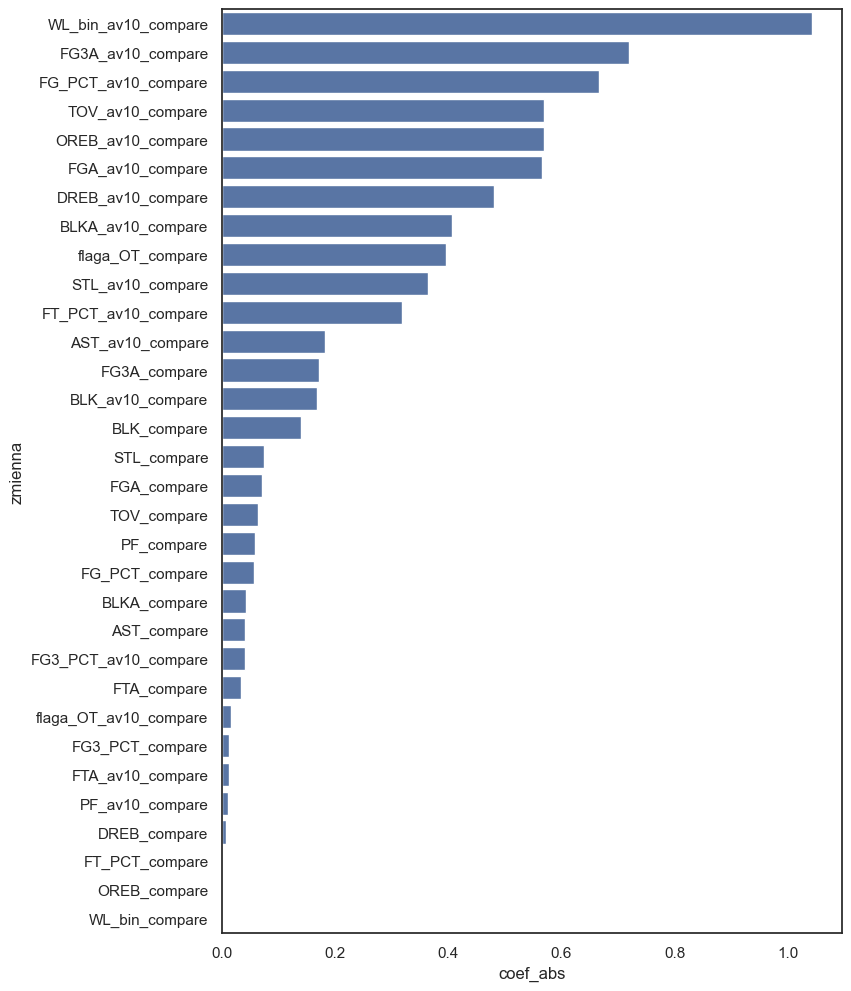

In [81]:
logreg_coefficients = best_pipeline_diff.named_steps['logreg'].coef_[0]
selected_columns = [col for col in selected_columns_diff if f'_av{best_N}' in col] + [''.join([col, '_compare']) for col in selected_columns_base]
df_features = pd.DataFrame({'zmienna': selected_columns, 'coef': logreg_coefficients})
df_features['coef_abs'] = np.abs(df_features['coef'])

plt.figure(figsize=(8, 12))
ax = sns.barplot(df_features.sort_values('coef_abs', ascending=False),
            y='zmienna',
            x='coef_abs')
plt.show()